# Start of Home Test - Machine Learning Engineer

# 🧢 Bottle Cap Defect Detection: Edge Deployment Approach

## 1. Problem Statement & Constraints
The objective of this project is to develop a robust object detection pipeline to classify bottle caps (**Light Blue**, **Dark Blue**, **Others**) suitable for deployment on edge devices (Raspberry Pi 5).

**Key Challenges:**
* **Edge Constraint:** The model must achieve an inference latency of **<10ms per frame** on the target hardware.
* **Noisy Data:** The provided dataset contained significant label noise, where all instances were initially labeled as `class 0`.
* **Visual Similarity:** Distinguishing between "Light Blue" and "Dark Blue" caps requires a model sensitive to subtle color feature variations under different lighting conditions.

## 2. Data Strategy: Semi-Automated Relabeling
To address the noisy label issue without manually annotating thousands of images, I implemented a **Semi-Automatic Relabeling Strategy** using Computer Vision techniques:

* **Approach:** HSV (Hue, Saturation, Value) Color Thresholding.
* **Process:** I analyzed the pixel distribution of the caps to define specific HSV ranges for Light and Dark Blue. Masks were generated to automatically separate these classes, correcting the dataset labels efficiently before training.
* **Augmentation:** Albumentations (Blur, CLAHE, HueShift) were applied to improve the model's resilience against lighting changes.

## Download libraries for the latest version.


In [1]:
pip install ultralytics wandb split-folders

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 16.7 MB/s eta 0:00:00


## Import the libraries

In [2]:
import cv2
import matplotlib.pyplot as plt
import numpy as np
import os
import gdown
import glob
import splitfolders
import shutil
import albumentations as A
import math
import yaml
from ultralytics import YOLO

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


In [3]:
import os
os.environ['WANDB_API_KEY'] = '9b9580c73de6d6cd3c6bbcb0d787964ea16b1737'

## Download dataset from Google Drive link that you've given.

In [4]:
# Link: https://drive.google.com/file/d/1vbMFTe2E5OHp2h5o_YL-RUoIFKxsrZWT
# File ID: 1vbMFTe2E5OHp2h5o_YL-RUoIFKxsrZWT
!gdown --id 1vbMFTe2E5OHp2h5o_YL-RUoIFKxsrZWT -O dataset.zip

/usr/local/lib/python3.12/dist-packages/gdown/__main__.py:140: FutureWarning: Option `--id` was deprecated in version 4.3.1 and will be removed in 5.0. You don't need to pass it anymore to use a file ID.
  warnings.warn(
Downloading...
From: https://drive.google.com/uc?id=1vbMFTe2E5OHp2h5o_YL-RUoIFKxsrZWT
To: /content/dataset.zip
100% 594k/594k [00:00<00:00, 40.9MB/s]


## Unzip Dataset

In [5]:
!unzip -q dataset.zip -d ./bottle_cap_dataset

## Check the file structure

In [6]:
!ls -R ./bottle_cap_dataset/

./bottle_cap_dataset/:
sample

./bottle_cap_dataset/sample:
raw-250110_dc_s001_b2_15.jpg  raw-250110_dc_s001_b4_1.jpg
raw-250110_dc_s001_b2_15.txt  raw-250110_dc_s001_b4_1.txt
raw-250110_dc_s001_b2_1.jpg   raw-250110_dc_s001_b4_2.jpg
raw-250110_dc_s001_b2_1.txt   raw-250110_dc_s001_b4_2.txt
raw-250110_dc_s001_b2_3.jpg   raw-250110_dc_s001_b4_3.jpg
raw-250110_dc_s001_b2_3.txt   raw-250110_dc_s001_b4_3.txt
raw-250110_dc_s001_b3_2.jpg   raw-250110_dc_s001_b5_2.jpg
raw-250110_dc_s001_b3_2.txt   raw-250110_dc_s001_b5_2.txt
raw-250110_dc_s001_b3_3.jpg   raw-250110_dc_s001_b5_3.jpg
raw-250110_dc_s001_b3_3.txt   raw-250110_dc_s001_b5_3.txt
raw-250110_dc_s001_b3_4.jpg   raw-250110_dc_s001_b5_5.jpg
raw-250110_dc_s001_b3_4.txt   raw-250110_dc_s001_b5_5.txt


## Helper function to visualize.

In [51]:
def plot_bounding_boxes(image_path, label_path):
    """
    Read an image and its YOLO label file, then draw bounding boxes on it.
    """
    # Read image
    image = cv2.imread(image_path)
    if image is None:
        print(f"Error: Cannot read image from {image_path}")
        return

    # Convert BGR to RGB
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    h, w, _ = image.shape

    print(f"Image: {os.path.basename(image_path)}, Size: ({w}, {h})")

    # Read label file
    if not os.path.exists(label_path):
        print(f"Info: No label file found at {label_path}")
    else:
        with open(label_path, 'r') as f:
            for line in f:
                parts = line.strip().split()
                if len(parts) != 5:
                    print(f"Warning: Invalid label format in {label_path}")
                    continue

                class_id = int(parts[0])
                x_center_norm = float(parts[1])
                y_center_norm = float(parts[2])
                width_norm = float(parts[3])
                height_norm = float(parts[4])

                # Convert normalized YOLO format to pixel coordinates
                box_w = width_norm * w
                box_h = height_norm * h
                x_center = x_center_norm * w
                y_center = y_center_norm * h

                x1 = int(x_center - box_w / 2)
                y1 = int(y_center - box_h / 2)
                x2 = int(x_center + box_w / 2)
                y2 = int(y_center + box_h / 2)

                cv2.rectangle(image_rgb, (x1, y1), (x2, y2), (0, 255, 0), 2)

                cv2.putText(
                    image_rgb,
                    f'Class: {class_id}',
                    (x1, y1 - 10),
                    cv2.FONT_HERSHEY_SIMPLEX,
                    0.6,
                    (0, 255, 0),
                    2
                )

                print(f"  > Found Class {class_id} at [{x1}, {y1}, {x2}, {y2}]")

    # Display the image
    plt.figure(figsize=(10, 10))
    plt.imshow(image_rgb)
    plt.axis('off')
    plt.show()


## Let's try to visualize one sample.

Attempting visualization:
  Image: ./bottle_cap_dataset/sample/raw-250110_dc_s001_b2_1.jpg
  Label: ./bottle_cap_dataset/sample/raw-250110_dc_s001_b2_1.txt
Image: raw-250110_dc_s001_b2_1.jpg, Size: (800, 998)
  > Found Class 0 at [320, 457, 385, 517]
  > Found Class 0 at [216, 782, 281, 844]
  > Found Class 0 at [119, 416, 185, 476]


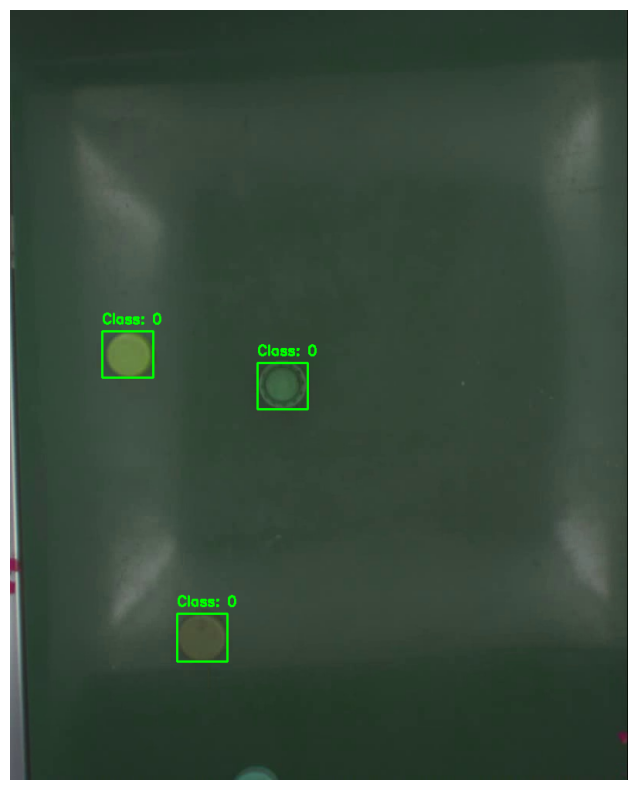

In [54]:
data_dir = './bottle_cap_dataset/sample/'

if not os.path.isdir(data_dir):
    print(f"Error: Directory {data_dir} not found.")
else:
    try:
        image_files = glob.glob(os.path.join(data_dir, '*.jpg'))
        if not image_files:
            image_files = glob.glob(os.path.join(data_dir, '*.png'))

        if not image_files:
            raise FileNotFoundError(f"No .jpg or .png files found in {data_dir}")

        sample_image_path = sorted(image_files)[0]
        sample_image_name = os.path.basename(sample_image_path)
        sample_label_name = os.path.splitext(sample_image_name)[0] + '.txt'
        sample_label_path = os.path.join(data_dir, sample_label_name)

        print("Attempting visualization:")
        print(f"  Image: {sample_image_path}")
        print(f"  Label: {sample_label_path}")

        plot_bounding_boxes(sample_image_path, sample_label_path)

    except FileNotFoundError as e:
        print(f"Error: {e}")
    except IndexError:
        print(f"Error: No images found in {data_dir}")
    except Exception as e:
        print(f"Unexpected error: {e}")


## Visualize all of the image on Sample folder

Found 12 images. Starting visualization...

--------------------------------------------------
Image: raw-250110_dc_s001_b2_1.jpg, Size: (800, 998)
  > Found Class 0 at [320, 457, 385, 517]
  > Found Class 0 at [216, 782, 281, 844]
  > Found Class 0 at [119, 416, 185, 476]


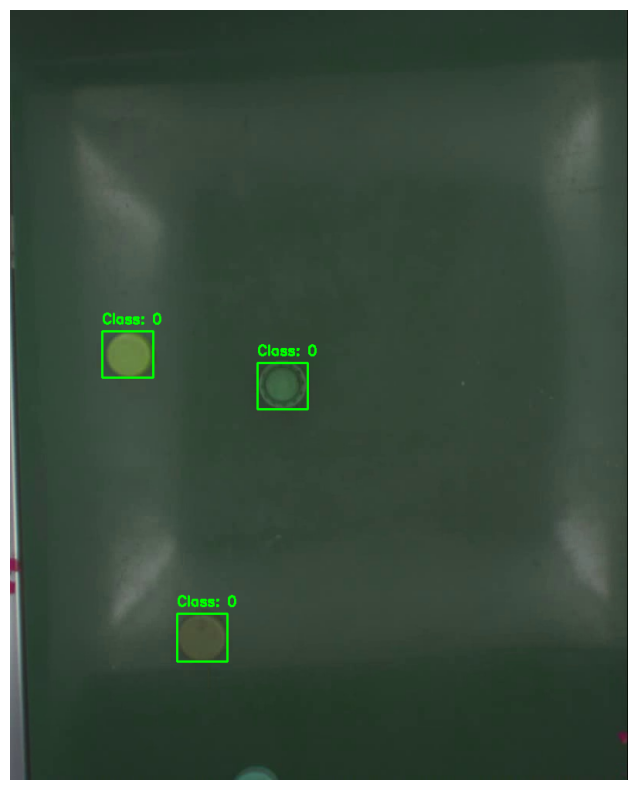

--------------------------------------------------
Image: raw-250110_dc_s001_b2_15.jpg, Size: (800, 998)
  > Found Class 0 at [346, 67, 414, 132]
  > Found Class 0 at [574, 459, 642, 526]
  > Found Class 0 at [482, 374, 547, 438]
  > Found Class 0 at [423, 424, 493, 491]
  > Found Class 0 at [328, 785, 395, 848]
  > Found Class 0 at [391, 178, 455, 240]
  > Found Class 0 at [590, 253, 659, 320]


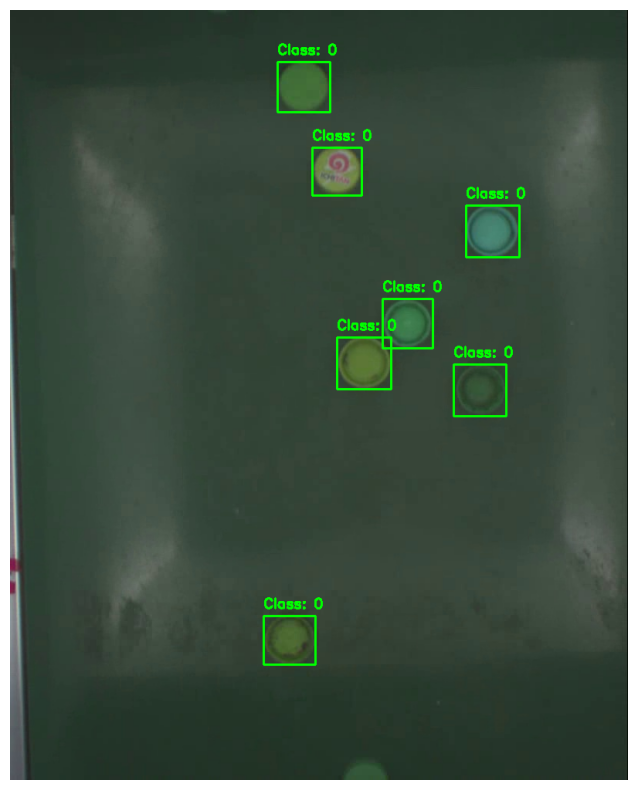

--------------------------------------------------
Image: raw-250110_dc_s001_b2_3.jpg, Size: (800, 998)
  > Found Class 0 at [261, 90, 328, 156]
  > Found Class 0 at [477, 130, 543, 195]
  > Found Class 0 at [416, 837, 482, 904]
  > Found Class 0 at [325, 598, 387, 656]
  > Found Class 0 at [147, 432, 232, 515]
  > Found Class 0 at [233, 714, 299, 776]
  > Found Class 0 at [302, 208, 363, 265]


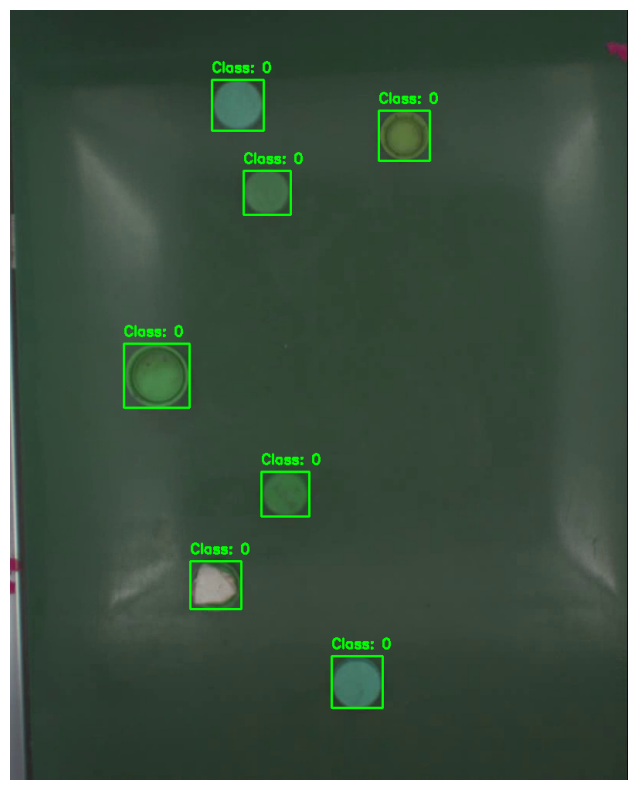

--------------------------------------------------
Image: raw-250110_dc_s001_b3_2.jpg, Size: (800, 998)
  > Found Class 0 at [467, 458, 532, 525]
  > Found Class 0 at [248, 783, 314, 849]
  > Found Class 0 at [600, 75, 666, 143]
  > Found Class 0 at [514, 195, 581, 269]
  > Found Class 0 at [290, 184, 356, 253]
  > Found Class 0 at [210, 356, 274, 419]
  > Found Class 0 at [94, 83, 162, 150]
  > Found Class 0 at [113, 606, 180, 671]
  > Found Class 0 at [592, 434, 657, 499]


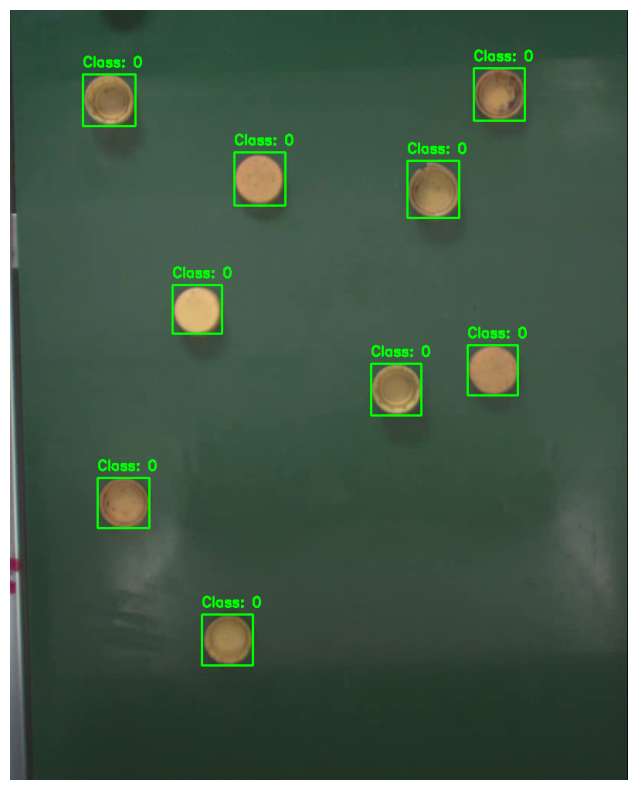

--------------------------------------------------
Image: raw-250110_dc_s001_b3_3.jpg, Size: (800, 998)
  > Found Class 0 at [431, 375, 497, 443]
  > Found Class 0 at [426, 494, 491, 559]
  > Found Class 0 at [231, 647, 298, 716]
  > Found Class 0 at [80, 431, 148, 497]
  > Found Class 0 at [166, 295, 232, 364]
  > Found Class 0 at [343, 192, 409, 261]
  > Found Class 0 at [318, 11, 385, 80]
  > Found Class 0 at [168, 0, 235, 39]


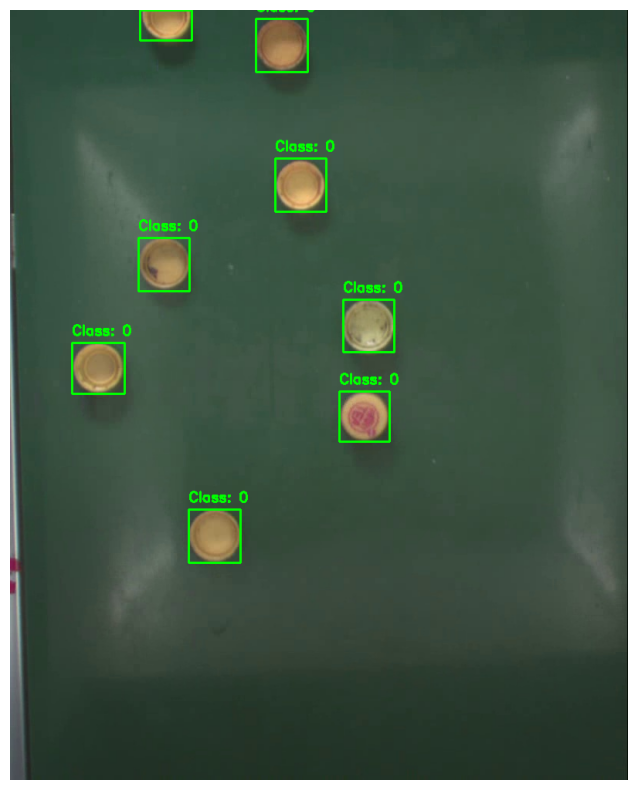

--------------------------------------------------
Image: raw-250110_dc_s001_b3_4.jpg, Size: (800, 998)
  > Found Class 0 at [595, 131, 661, 199]
  > Found Class 0 at [355, 306, 421, 374]
  > Found Class 0 at [308, 206, 374, 270]
  > Found Class 0 at [264, 48, 330, 115]
  > Found Class 0 at [211, 726, 278, 793]
  > Found Class 0 at [484, 645, 550, 711]
  > Found Class 0 at [308, 518, 374, 583]
  > Found Class 0 at [529, 858, 594, 926]
  > Found Class 0 at [527, 444, 594, 512]
  > Found Class 0 at [403, 203, 468, 268]


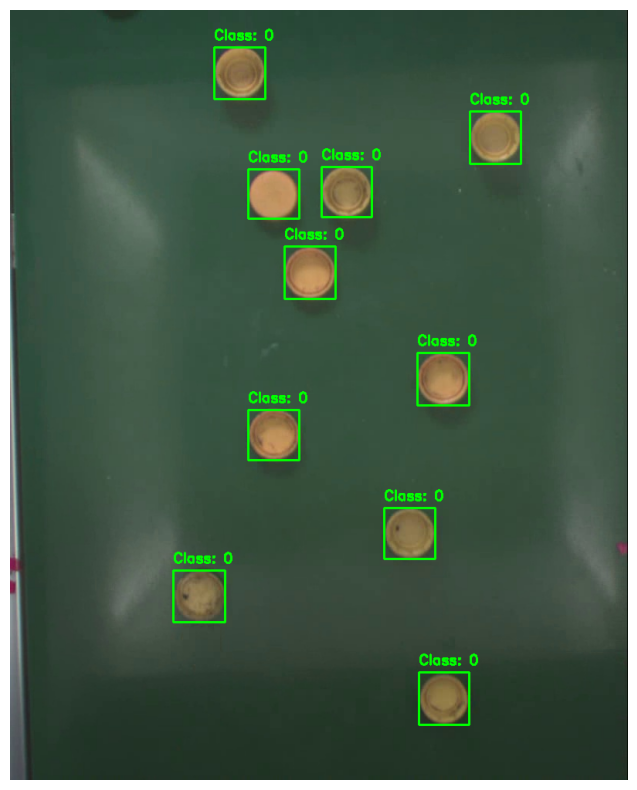

--------------------------------------------------
Image: raw-250110_dc_s001_b4_1.jpg, Size: (800, 998)
  > Found Class 0 at [366, 801, 432, 867]
  > Found Class 0 at [549, 466, 617, 536]
  > Found Class 0 at [443, 633, 510, 702]
  > Found Class 0 at [183, 417, 250, 486]
  > Found Class 0 at [229, 605, 296, 674]


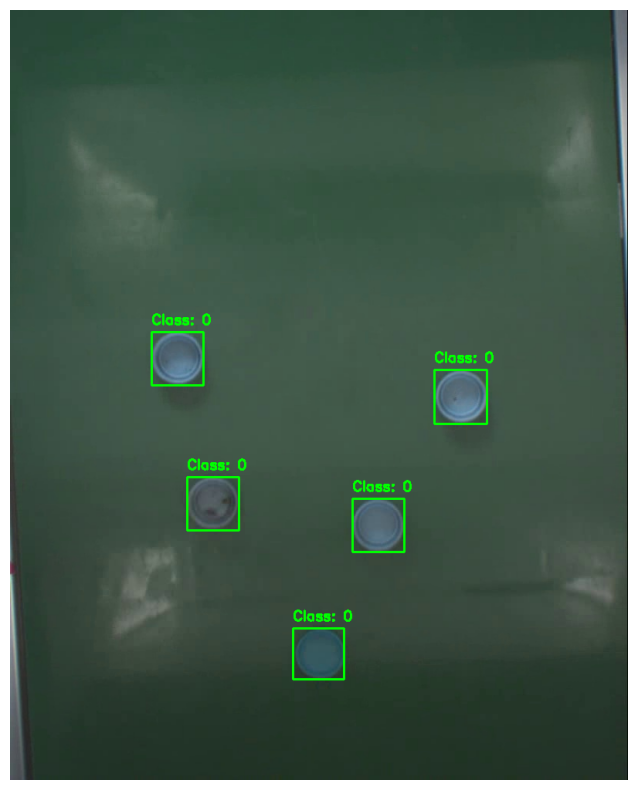

--------------------------------------------------
Image: raw-250110_dc_s001_b4_2.jpg, Size: (800, 998)
  > Found Class 0 at [544, 310, 611, 379]
  > Found Class 0 at [175, 258, 241, 328]
  > Found Class 0 at [219, 448, 287, 516]
  > Found Class 0 at [360, 647, 426, 713]
  > Found Class 0 at [119, 907, 186, 971]
  > Found Class 0 at [435, 477, 502, 546]


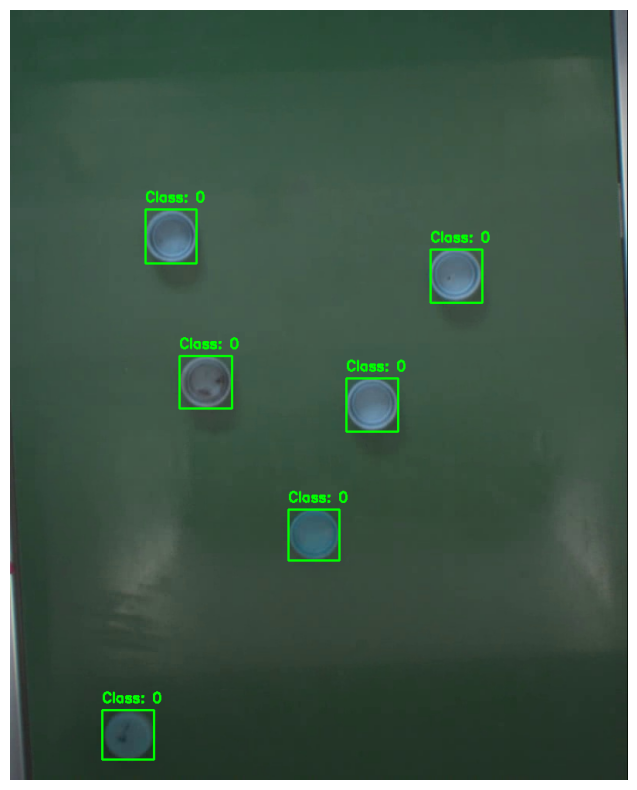

--------------------------------------------------
Image: raw-250110_dc_s001_b4_3.jpg, Size: (800, 998)
  > Found Class 0 at [163, 67, 232, 138]
  > Found Class 0 at [425, 287, 491, 356]
  > Found Class 0 at [350, 458, 416, 525]
  > Found Class 0 at [208, 258, 276, 327]
  > Found Class 0 at [533, 116, 600, 186]
  > Found Class 0 at [111, 725, 174, 787]
  > Found Class 0 at [432, 842, 498, 908]


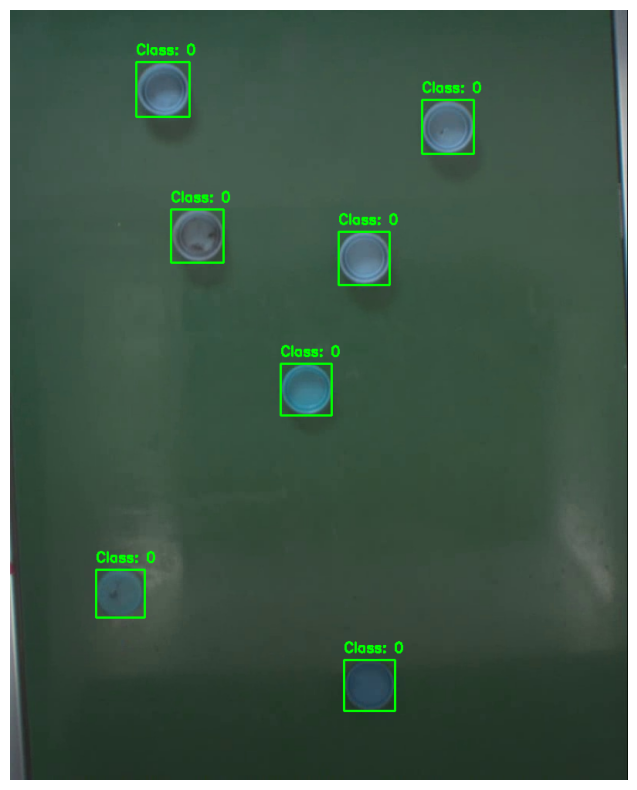

--------------------------------------------------
Image: raw-250110_dc_s001_b5_2.jpg, Size: (800, 998)
  > Found Class 0 at [290, 573, 351, 632]
  > Found Class 0 at [468, 307, 534, 375]
  > Found Class 0 at [375, 821, 436, 880]
  > Found Class 0 at [211, 285, 273, 344]
  > Found Class 0 at [344, 440, 409, 509]


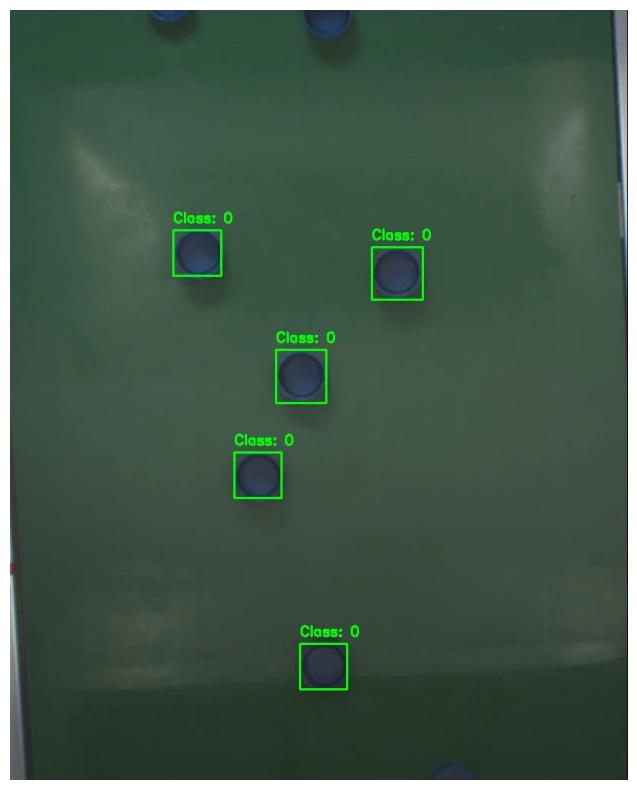

--------------------------------------------------
Image: raw-250110_dc_s001_b5_3.jpg, Size: (800, 998)
  > Found Class 0 at [278, 363, 341, 430]
  > Found Class 0 at [335, 233, 400, 294]
  > Found Class 0 at [200, 69, 265, 138]
  > Found Class 0 at [532, 769, 596, 835]
  > Found Class 0 at [364, 609, 428, 676]
  > Found Class 0 at [457, 93, 521, 163]
  > Found Class 0 at [249, 936, 319, 995]


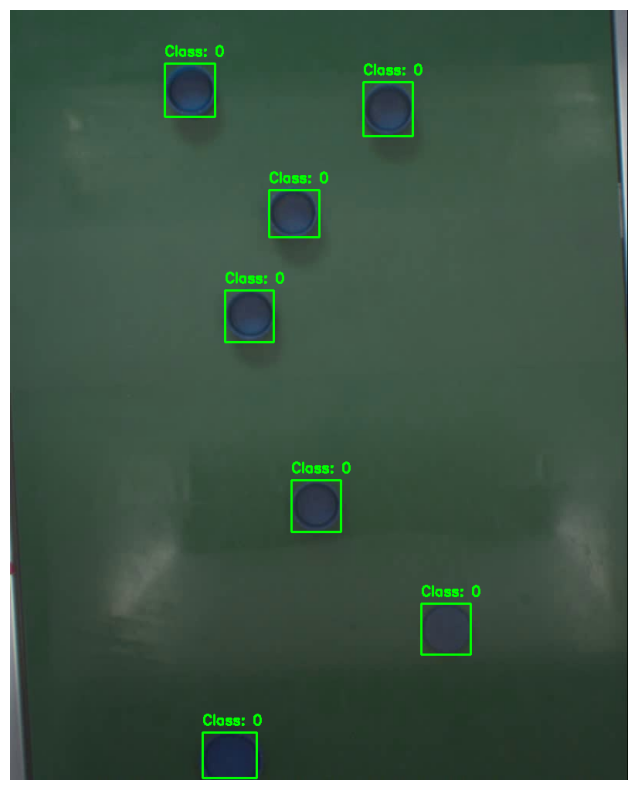

--------------------------------------------------
Image: raw-250110_dc_s001_b5_5.jpg, Size: (800, 998)
  > Found Class 0 at [472, 458, 537, 526]
  > Found Class 0 at [586, 837, 652, 903]
  > Found Class 0 at [500, 112, 565, 176]
  > Found Class 0 at [209, 276, 292, 362]
  > Found Class 0 at [271, 792, 335, 862]


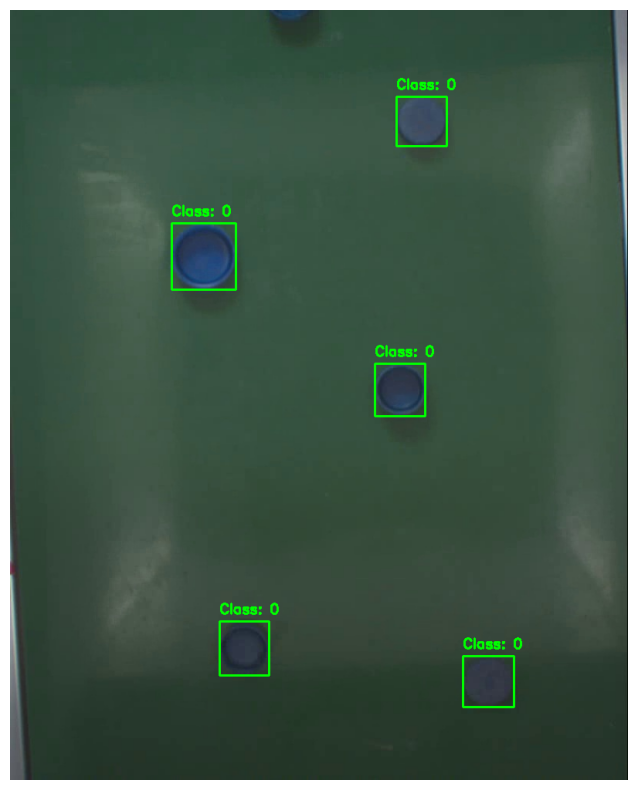

In [55]:
data_dir = './bottle_cap_dataset/sample/'

if not os.path.isdir(data_dir):
    print(f"Error: Directory {data_dir} not found.")
else:
    try:
        image_files = glob.glob(os.path.join(data_dir, '*.jpg'))
        if not image_files:
            image_files = glob.glob(os.path.join(data_dir, '*.png'))

        if not image_files:
            raise FileNotFoundError(f"No .jpg or .png files found in {data_dir}")

        print(f"Found {len(image_files)} images. Starting visualization...\n")

        for sample_image_path in sorted(image_files):
            sample_image_name = os.path.basename(sample_image_path)
            sample_label_name = os.path.splitext(sample_image_name)[0] + '.txt'
            sample_label_path = os.path.join(data_dir, sample_label_name)

            print("-" * 50)
            plot_bounding_boxes(sample_image_path, sample_label_path)

    except FileNotFoundError as e:
        print(f"Error: {e}")
    except Exception as e:
        print(f"Unexpected error: {e}")


## Conclusion of the problem

All of the image on dataset are labeled class 0. I need to relabelling the bottle cap on the image based on the bottle cap color.

## Analyzing Color Function

In [10]:
def get_mean_color_hsv (crop):

  # count every mean of color channel (B, G, R)
  # This mean is the array of every mean the color channel
  mean_bgr = np.mean(crop, axis=(0, 1))
  # change the BGD 1D array to become 1x1 pixel image for able to be converted by cv2.cvtColor
  mean_bgr_pixel = np.uint8([[mean_bgr]])
  # convert BGR to HSV
  mean_hsv_pixel = cv2.cvtColor(mean_bgr_pixel, cv2.COLOR_BGR2HSV)

  # The results are [[ [H, S, V]]]
  return mean_hsv_pixel[0][0]

In [11]:
def analyze_image_colors(image_path, label_path):
    """
    Read the image and label, then crop every box and analyze its mean of colors.
    """
    image = cv2.imread(image_path)
    if image is None:
      print(f"Error: Can't read the image {image_path}")
      return

    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    h, w, _ = image.shape

    print(f"\n" + "="*50)
    print(f"Analyzing the image: {os.path.basename(image_path)}")
    print(f"Size: ({w}, {h})")

    # Showing the actual image
    plt.figure(figsize=(10, 10))
    plt.imshow(image_rgb)
    plt.title(f"Actual image: {os.path.basename(image_path)}")
    plt.axis('off')
    plt.show()

    # Subplots for showing the crops
    crops = []

    if not os.path.exists(label_path):
        print(f"Info: There is no label in this {label_path}")
        return

    with open(label_path, 'r') as f:
        for line in f:
            parts = line.strip().split()
            if len(parts) != 5: continue

            # We don't use the class:0
            x_center_norm, y_center_norm, width_norm, height_norm = map(float, parts[1:])

            # Convert the YOLO coordinates
            box_w = width_norm * w
            box_h = height_norm * h
            x_center = x_center_norm * w
            y_center = y_center_norm * h

            x1 = int(x_center - (box_w / 2))
            y1 = int(y_center - (box_h / 2))
            x2 = int(x_center + (box_w / 2))
            y2 = int(y_center + (box_h / 2))

            # 1. Crop the BGR image
            crop = image[y1:y2, x1:x2]

            if crop.size == 0:
                print(f"  Warning: Gagal memotong, koordinat mungkin di luar batas.")
                print(f"  Warning: Crop failing, the coordinates may be out of bound.")
                continue

            # 2. Analyze the color
            hsv_mean = get_mean_color_hsv(crop)
            print(f"  > Box at [{x1}, {y1}, {x2}, {y2}] -> HSV color mean: {hsv_mean}")

            # Convert crop to RGB for plotting
            crops.append(cv2.cvtColor(crop, cv2.COLOR_BGR2RGB))

    # Show all of the crops
    if crops:
        print(f"Showing {len(crops)} crops from the image:")
        num_crops = len(crops)
        cols = 5  # Showing 5 crops each row
        rows = int(np.ceil(num_crops / cols))

        plt.figure(figsize=(15, 3 * rows))
        for i, crop_rgb in enumerate(crops):
            plt.subplot(rows, cols, i + 1)
            plt.imshow(crop_rgb)
            plt.axis('off')
        plt.tight_layout()
        plt.show()

## Apply the analyzing color function and find the Hue value to analyze the color of each object.


Analyzing the image: raw-250110_dc_s001_b2_1.jpg
Size: (800, 998)


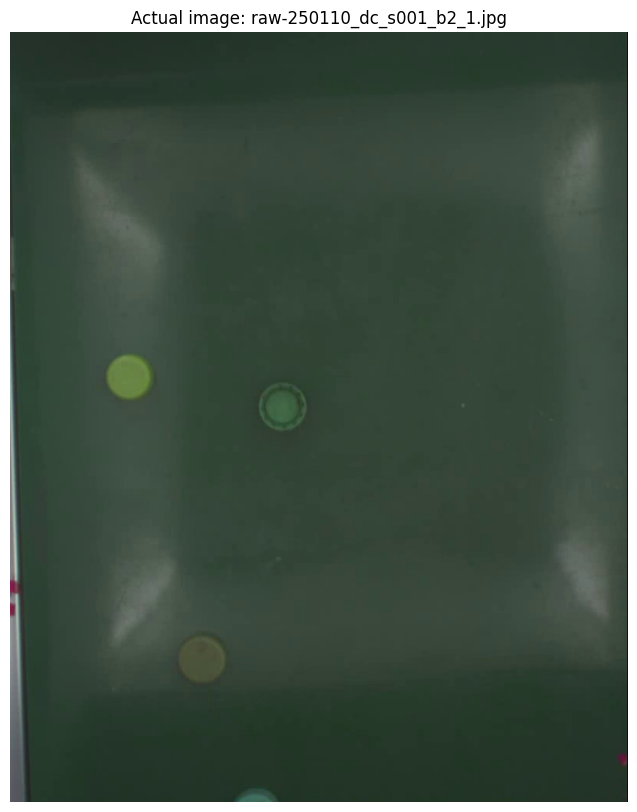

  > Box at [320, 457, 385, 517] -> HSV color mean: [63 86 83]
  > Box at [216, 782, 281, 844] -> HSV color mean: [41 69 78]
  > Box at [119, 416, 185, 476] -> HSV color mean: [ 45 108 113]
Showing 3 crops from the image:


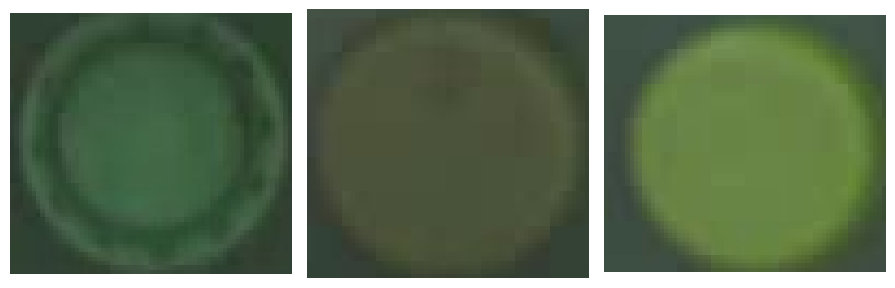


Analyzing the image: raw-250110_dc_s001_b2_15.jpg
Size: (800, 998)


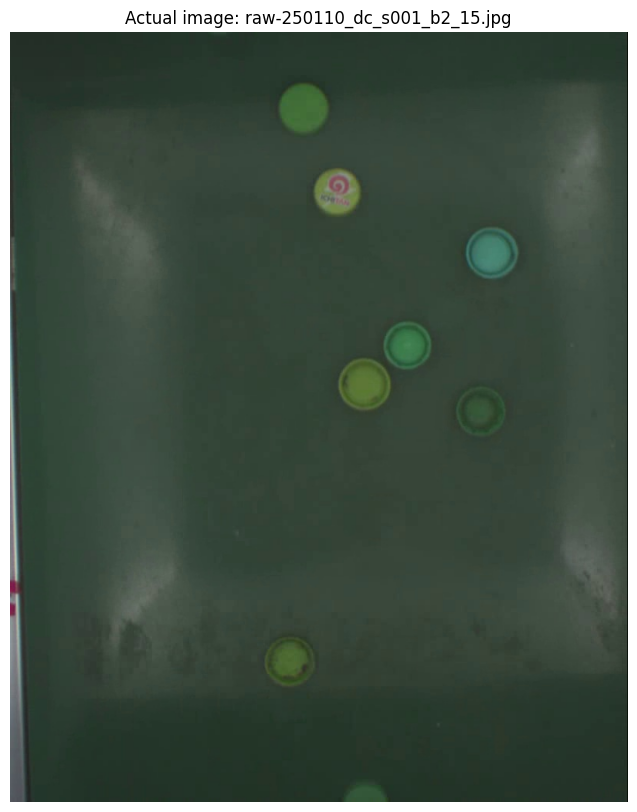

  > Box at [346, 67, 414, 132] -> HSV color mean: [ 56 111  94]
  > Box at [574, 459, 642, 526] -> HSV color mean: [61 78 72]
  > Box at [482, 374, 547, 438] -> HSV color mean: [ 67 112  96]
  > Box at [423, 424, 493, 491] -> HSV color mean: [ 45 120  96]
  > Box at [328, 785, 395, 848] -> HSV color mean: [ 47 110  81]
  > Box at [391, 178, 455, 240] -> HSV color mean: [ 37  70 106]
  > Box at [590, 253, 659, 320] -> HSV color mean: [ 80 108 102]
Showing 7 crops from the image:


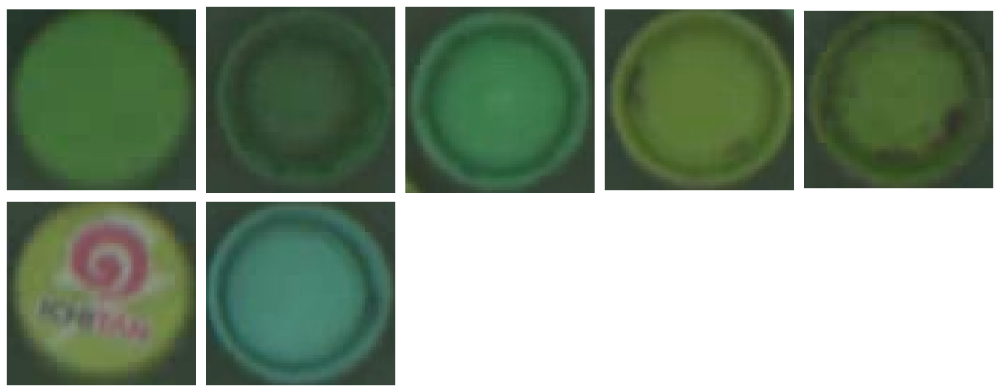


Analyzing the image: raw-250110_dc_s001_b2_3.jpg
Size: (800, 998)


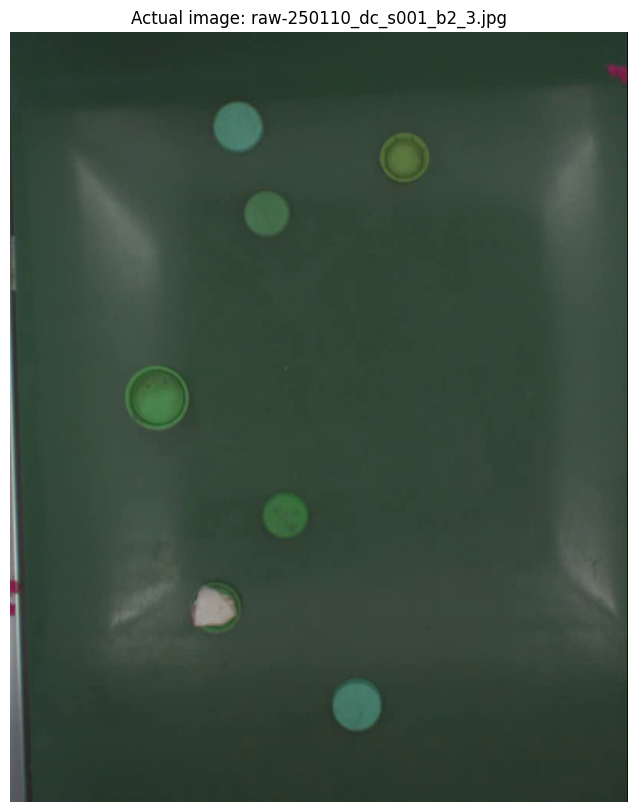

  > Box at [261, 90, 328, 156] -> HSV color mean: [ 78  95 105]
  > Box at [477, 130, 543, 195] -> HSV color mean: [ 47 107  93]
  > Box at [416, 837, 482, 904] -> HSV color mean: [ 79 104 101]
  > Box at [325, 598, 387, 656] -> HSV color mean: [ 62 107  93]
  > Box at [147, 432, 232, 515] -> HSV color mean: [ 59 100 102]
  > Box at [233, 714, 299, 776] -> HSV color mean: [ 44  34 114]
  > Box at [302, 208, 363, 265] -> HSV color mean: [65 89 95]
Showing 7 crops from the image:


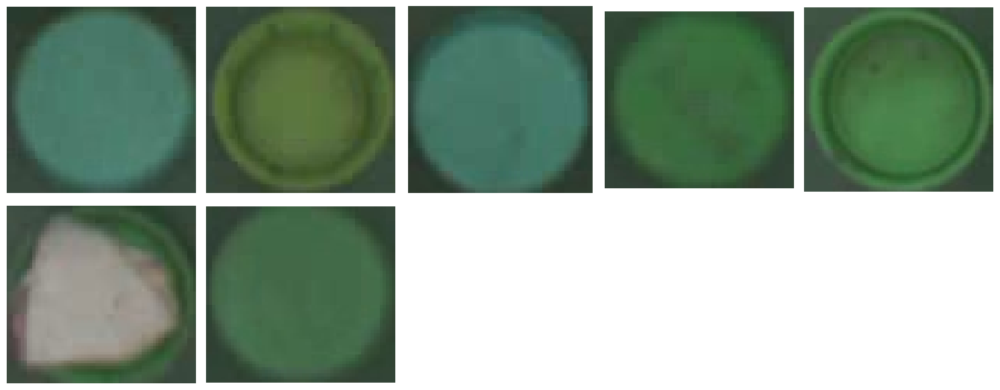


Analyzing the image: raw-250110_dc_s001_b3_2.jpg
Size: (800, 998)


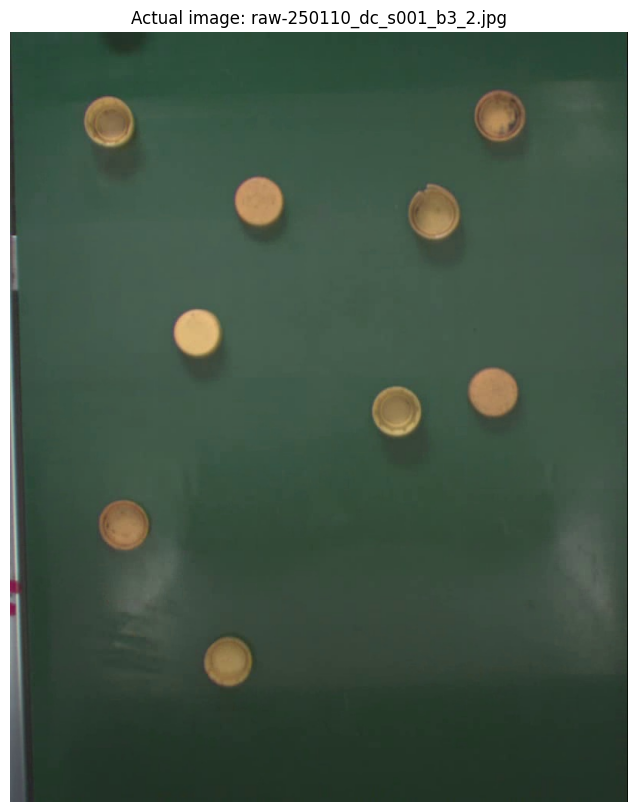

  > Box at [467, 458, 532, 525] -> HSV color mean: [ 23 102 128]
  > Box at [248, 783, 314, 849] -> HSV color mean: [ 21 110 114]
  > Box at [600, 75, 666, 143] -> HSV color mean: [ 17 105 119]
  > Box at [514, 195, 581, 269] -> HSV color mean: [ 20  97 124]
  > Box at [290, 184, 356, 253] -> HSV color mean: [ 18 104 150]
  > Box at [210, 356, 274, 419] -> HSV color mean: [ 20  98 174]
  > Box at [94, 83, 162, 150] -> HSV color mean: [ 21 101 124]
  > Box at [113, 606, 180, 671] -> HSV color mean: [ 17 108 125]
  > Box at [592, 434, 657, 499] -> HSV color mean: [ 17 104 145]
Showing 9 crops from the image:


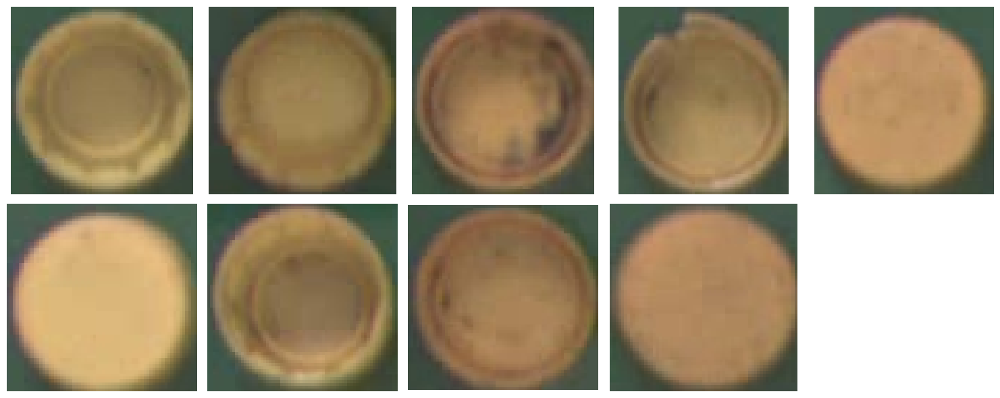


Analyzing the image: raw-250110_dc_s001_b3_3.jpg
Size: (800, 998)


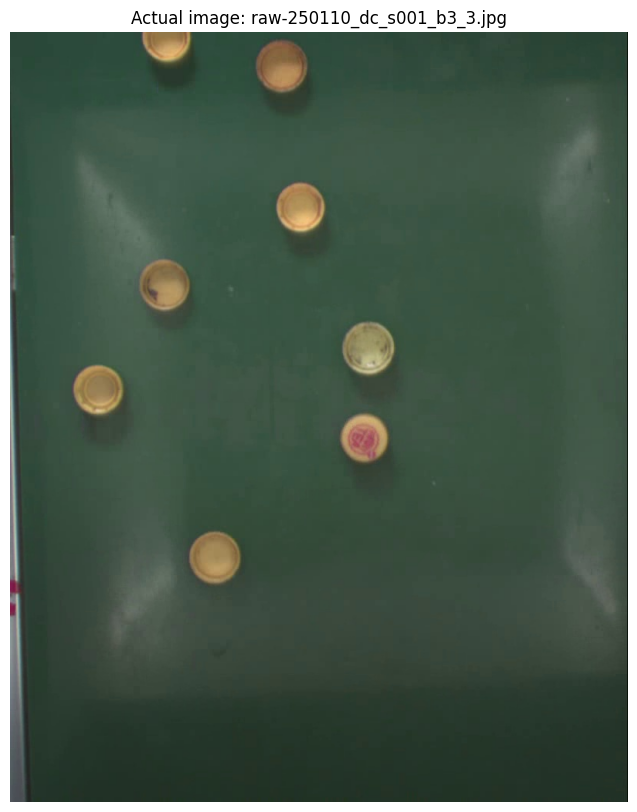

  > Box at [431, 375, 497, 443] -> HSV color mean: [ 28  74 135]
  > Box at [426, 494, 491, 559] -> HSV color mean: [ 13  95 142]
  > Box at [231, 647, 298, 716] -> HSV color mean: [ 20 107 133]
  > Box at [80, 431, 148, 497] -> HSV color mean: [ 21 106 135]
  > Box at [166, 295, 232, 364] -> HSV color mean: [ 21  94 127]
  > Box at [343, 192, 409, 261] -> HSV color mean: [ 20 109 148]
  > Box at [318, 11, 385, 80] -> HSV color mean: [ 17 111 122]
  > Box at [168, 0, 235, 39] -> HSV color mean: [ 20 118 147]
Showing 8 crops from the image:


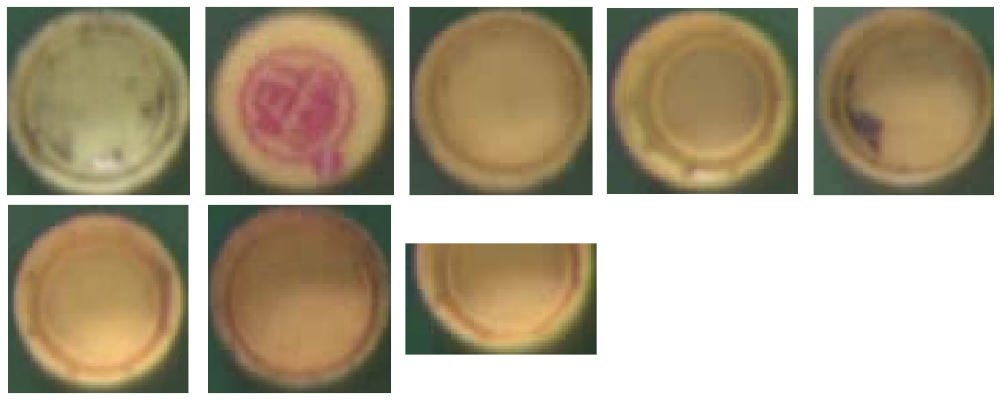


Analyzing the image: raw-250110_dc_s001_b3_4.jpg
Size: (800, 998)


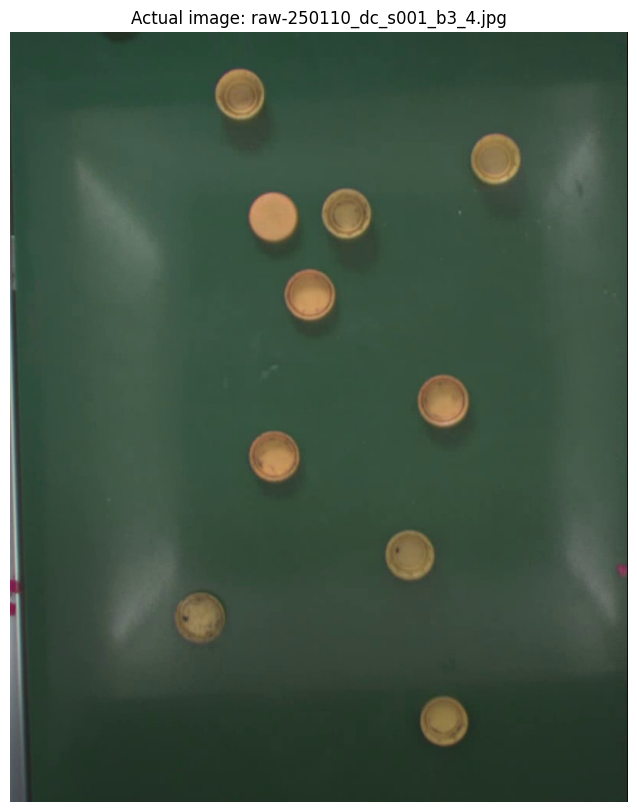

  > Box at [595, 131, 661, 199] -> HSV color mean: [ 22 104 128]
  > Box at [355, 306, 421, 374] -> HSV color mean: [ 17 117 142]
  > Box at [308, 206, 374, 270] -> HSV color mean: [ 17 112 157]
  > Box at [264, 48, 330, 115] -> HSV color mean: [ 20 107 124]
  > Box at [211, 726, 278, 793] -> HSV color mean: [ 22  87 106]
  > Box at [484, 645, 550, 711] -> HSV color mean: [ 23 102 113]
  > Box at [308, 518, 374, 583] -> HSV color mean: [ 17 118 138]
  > Box at [529, 858, 594, 926] -> HSV color mean: [ 23 115 102]
  > Box at [527, 444, 594, 512] -> HSV color mean: [ 18 113 135]
  > Box at [403, 203, 468, 268] -> HSV color mean: [ 22 103 124]
Showing 10 crops from the image:


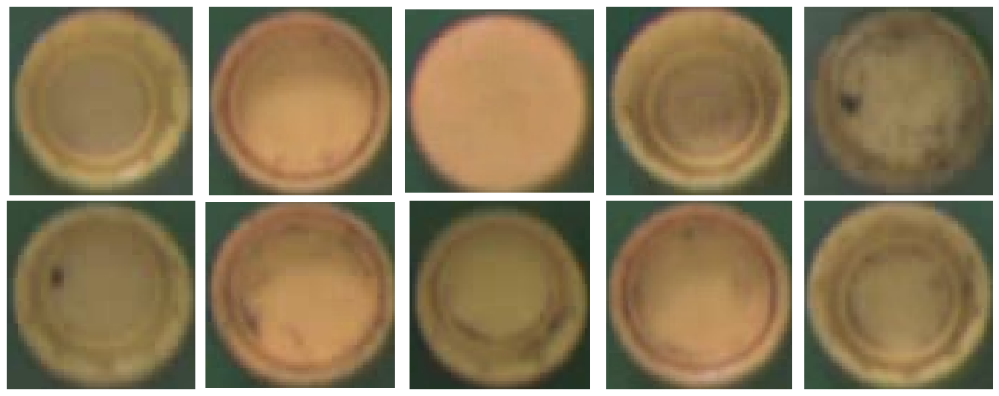


Analyzing the image: raw-250110_dc_s001_b4_1.jpg
Size: (800, 998)


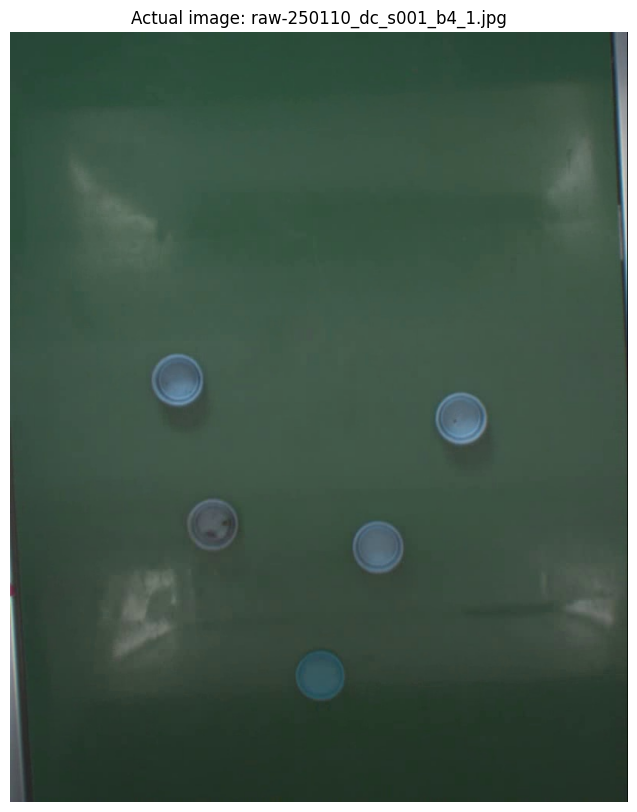

  > Box at [366, 801, 432, 867] -> HSV color mean: [ 92 102  80]
  > Box at [549, 466, 617, 536] -> HSV color mean: [ 99  77 120]
  > Box at [443, 633, 510, 702] -> HSV color mean: [ 99  69 103]
  > Box at [183, 417, 250, 486] -> HSV color mean: [100  82 118]
  > Box at [229, 605, 296, 674] -> HSV color mean: [90 37 83]
Showing 5 crops from the image:


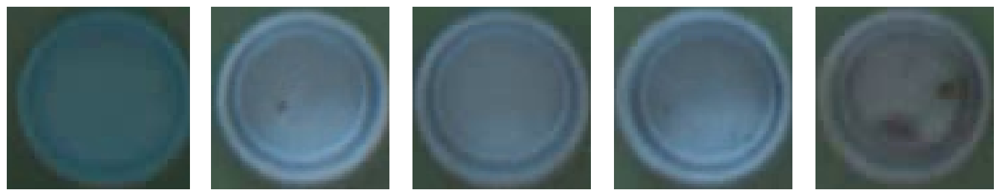


Analyzing the image: raw-250110_dc_s001_b4_2.jpg
Size: (800, 998)


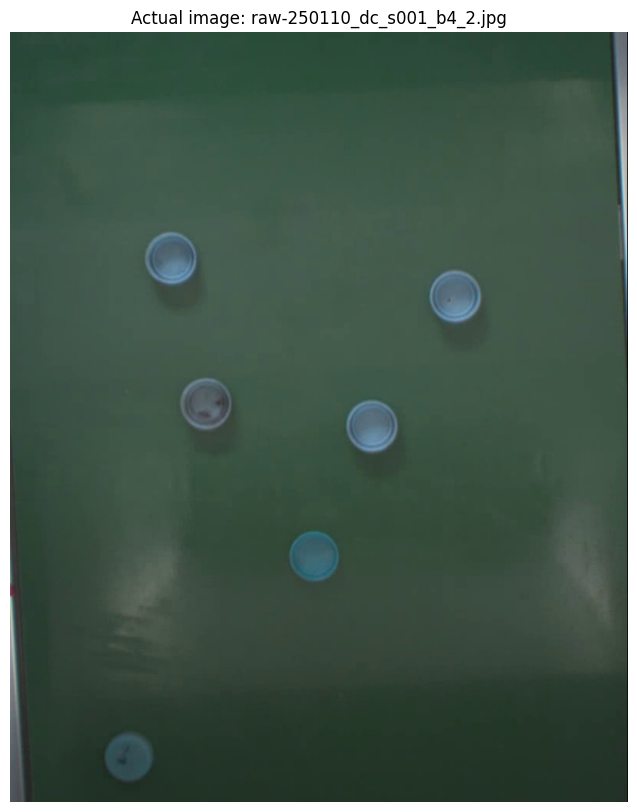

  > Box at [544, 310, 611, 379] -> HSV color mean: [ 99  80 124]
  > Box at [175, 258, 241, 328] -> HSV color mean: [100  84 121]
  > Box at [219, 448, 287, 516] -> HSV color mean: [96 43 95]
  > Box at [360, 647, 426, 713] -> HSV color mean: [ 93 116  97]
  > Box at [119, 907, 186, 971] -> HSV color mean: [91 87 70]
  > Box at [435, 477, 502, 546] -> HSV color mean: [ 99  82 121]
Showing 6 crops from the image:


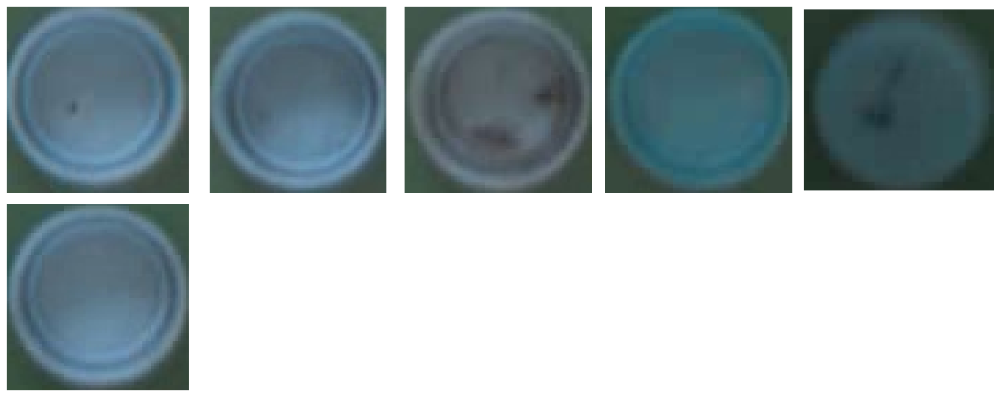


Analyzing the image: raw-250110_dc_s001_b4_3.jpg
Size: (800, 998)


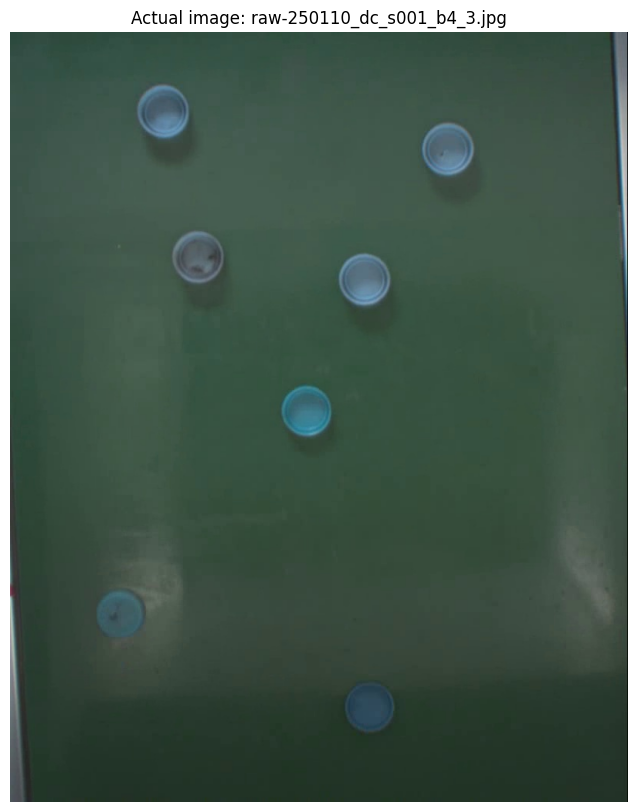

  > Box at [163, 67, 232, 138] -> HSV color mean: [100  91 118]
  > Box at [425, 287, 491, 356] -> HSV color mean: [ 99  84 125]
  > Box at [350, 458, 416, 525] -> HSV color mean: [ 94 136 116]
  > Box at [208, 258, 276, 327] -> HSV color mean: [95 44 98]
  > Box at [533, 116, 600, 186] -> HSV color mean: [ 99  80 121]
  > Box at [111, 725, 174, 787] -> HSV color mean: [93 83 92]
  > Box at [432, 842, 498, 908] -> HSV color mean: [ 98 110  74]
Showing 7 crops from the image:


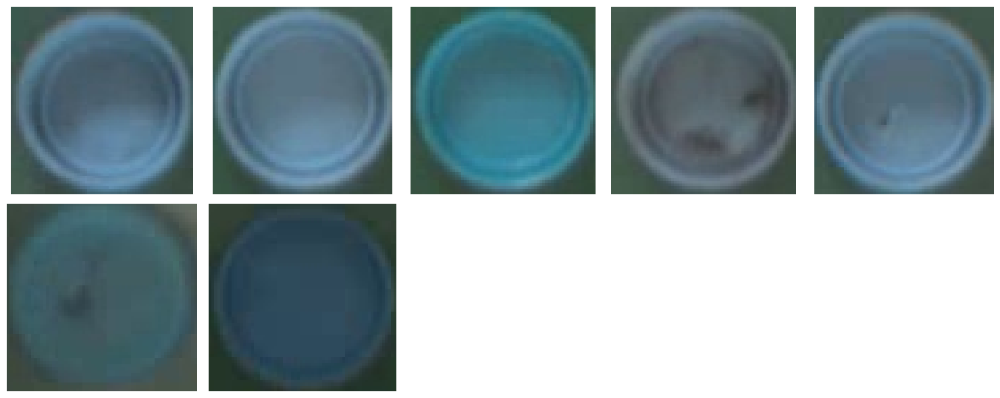


Analyzing the image: raw-250110_dc_s001_b5_2.jpg
Size: (800, 998)


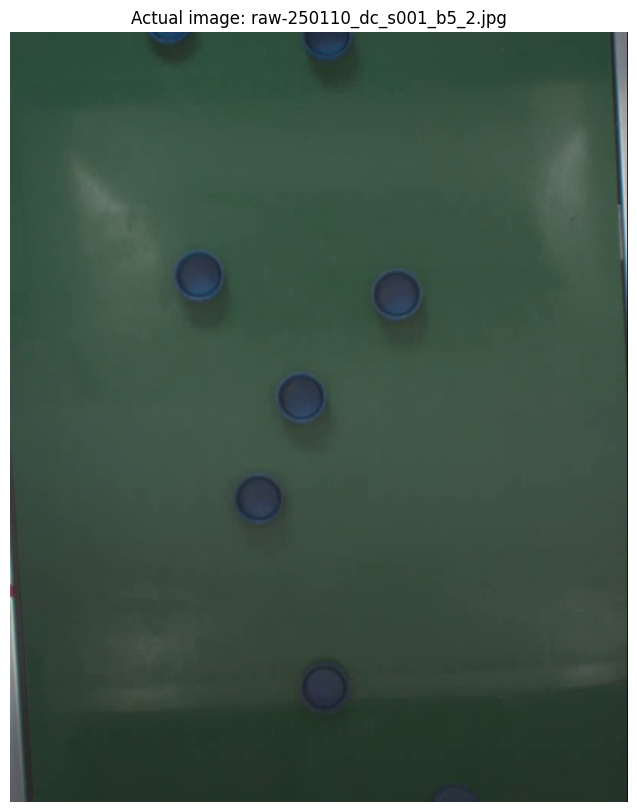

  > Box at [290, 573, 351, 632] -> HSV color mean: [105  86  71]
  > Box at [468, 307, 534, 375] -> HSV color mean: [102  90  74]
  > Box at [375, 821, 436, 880] -> HSV color mean: [105  78  59]
  > Box at [211, 285, 273, 344] -> HSV color mean: [104 108  80]
  > Box at [344, 440, 409, 509] -> HSV color mean: [102  91  76]
Showing 5 crops from the image:


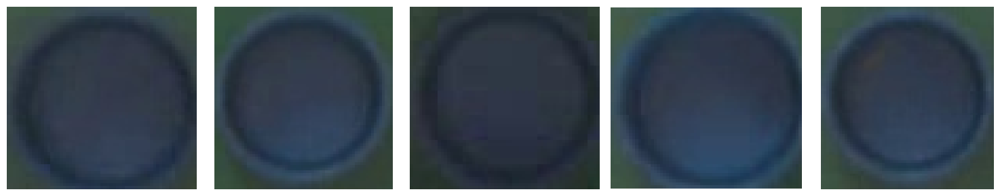


Analyzing the image: raw-250110_dc_s001_b5_3.jpg
Size: (800, 998)


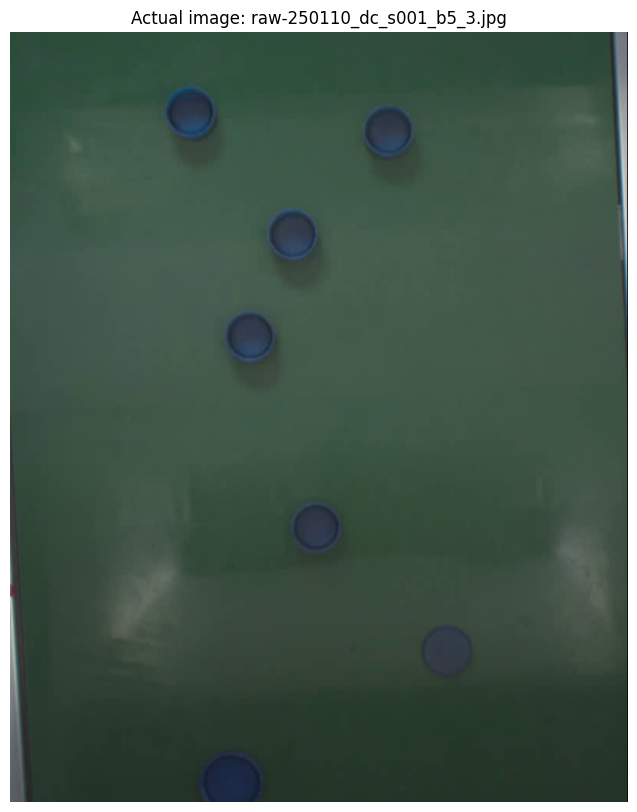

  > Box at [278, 363, 341, 430] -> HSV color mean: [104  95  78]
  > Box at [335, 233, 400, 294] -> HSV color mean: [104  97  79]
  > Box at [200, 69, 265, 138] -> HSV color mean: [102 121  78]
  > Box at [532, 769, 596, 835] -> HSV color mean: [102  59  65]
  > Box at [364, 609, 428, 676] -> HSV color mean: [104  84  67]
  > Box at [457, 93, 521, 163] -> HSV color mean: [103  95  75]
  > Box at [249, 936, 319, 995] -> HSV color mean: [110 146  63]
Showing 7 crops from the image:


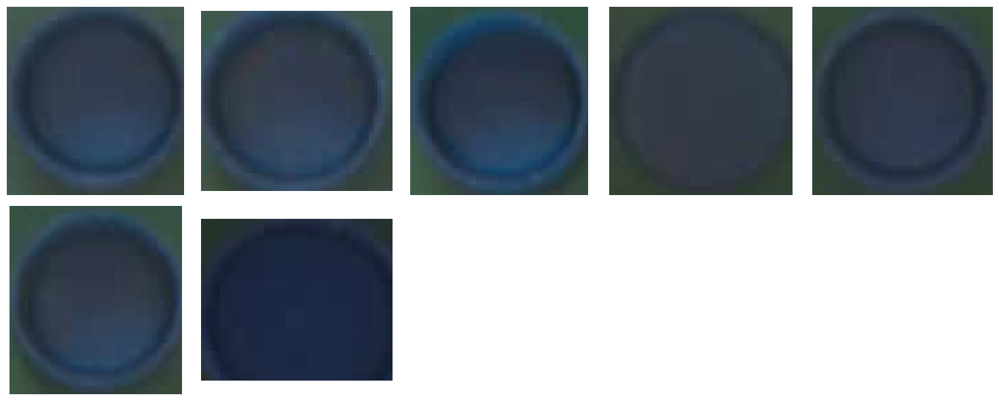


Analyzing the image: raw-250110_dc_s001_b5_5.jpg
Size: (800, 998)


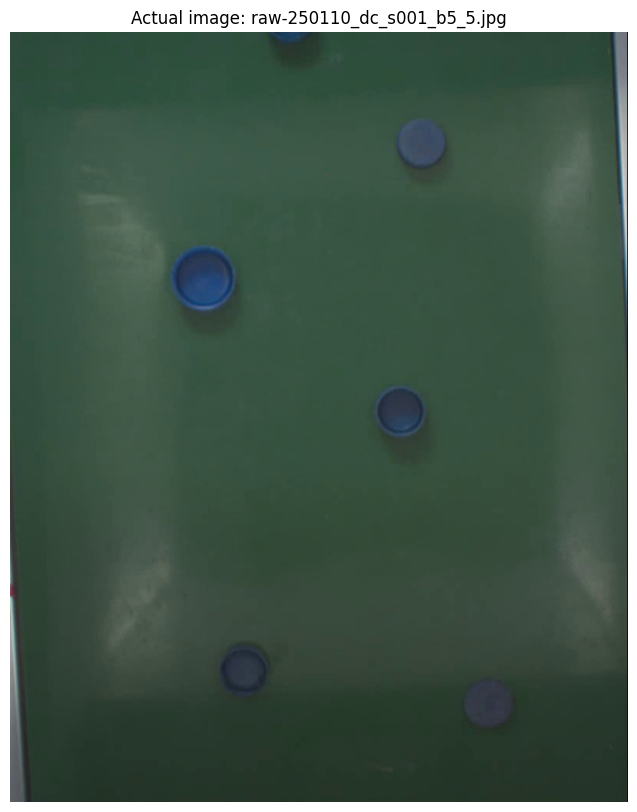

  > Box at [472, 458, 537, 526] -> HSV color mean: [103  99  75]
  > Box at [586, 837, 652, 903] -> HSV color mean: [102  54  61]
  > Box at [500, 112, 565, 176] -> HSV color mean: [103  86  89]
  > Box at [209, 276, 292, 362] -> HSV color mean: [105 145  97]
  > Box at [271, 792, 335, 862] -> HSV color mean: [102  73  59]
Showing 5 crops from the image:


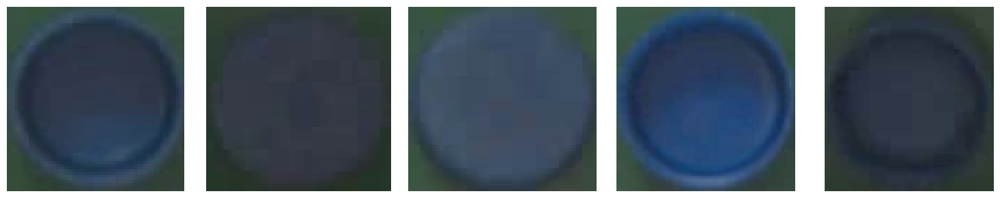

In [56]:
# Run analysis on all images
data_dir = './bottle_cap_dataset/sample/'
image_files = sorted(glob.glob(os.path.join(data_dir, '*.jpg')))

if not image_files:
    print("Error: No .jpg files found.")
else:
    for sample_image_path in image_files:
        sample_label_name = os.path.splitext(os.path.basename(sample_image_path))[0] + '.txt'
        sample_label_path = os.path.join(data_dir, sample_label_name)

        analyze_image_colors(sample_image_path, sample_label_path)


## Labeling the Bottle Cap with new label based on the Hue Value.

In [57]:
def classify_hsv(hsv_mean):
    """
    Classifies color based on the average HSV values.
    Replace threshold values with those obtained from your EDA.
    """
    H, S, V = hsv_mean

    # Replace these ranges with your actual findings
    LIGHT_BLUE_H_MIN = 90
    LIGHT_BLUE_H_MAX = 100

    DARK_BLUE_H_MIN = 101
    DARK_BLUE_H_MAX = 120

    if LIGHT_BLUE_H_MIN <= H <= LIGHT_BLUE_H_MAX:
        return 0, "Light Blue"

    elif DARK_BLUE_H_MIN <= H <= DARK_BLUE_H_MAX:
        return 1, "Dark Blue"

    return 2, "Others"


def plot_with_new_labels(image_path, label_path):
    """
    Reads an image, evaluates each bounding box, classifies it by HSV,
    and visualizes the result with the new color labels.
    """
    image = cv2.imread(image_path)
    if image is None:
        print(f"Error: Could not read {image_path}")
        return

    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    h, w, _ = image.shape

    print("\n" + "=" * 50)
    print(f"VERIFYING IMAGE: {os.path.basename(image_path)}")

    if not os.path.exists(label_path):
        print(f"Info: No label file found at {label_path}")
    else:
        with open(label_path, 'r') as f:
            for line in f:
                parts = line.strip().split()
                if len(parts) != 5:
                    continue

                x_center_norm, y_center_norm, width_norm, height_norm = map(float, parts[1:])

                box_w = width_norm * w
                box_h = height_norm * h
                x_center = x_center_norm * w
                y_center = y_center_norm * h

                x1 = int(x_center - box_w / 2)
                y1 = int(y_center - box_h / 2)
                x2 = int(x_center + box_w / 2)
                y2 = int(y_center + box_h / 2)

                crop = image[y1:y2, x1:x2]
                if crop.size == 0:
                    continue

                hsv_mean = get_mean_color_hsv(crop)
                new_class_id, class_name = classify_hsv(hsv_mean)

                if new_class_id == 0:
                    color = (255, 255, 0)
                elif new_class_id == 1:
                    color = (255, 0, 0)
                else:
                    color = (0, 0, 255)

                label_text = f"Class: {new_class_id} ({class_name})"
                cv2.rectangle(image_rgb, (x1, y1), (x2, y2), color, 2)
                cv2.putText(
                    image_rgb,
                    label_text,
                    (x1, y1 - 10),
                    cv2.FONT_HERSHEY_SIMPLEX,
                    0.7,
                    color,
                    2
                )

                print(f"  > Box [{x1},{y1}] | HSV: {hsv_mean} | Assigned: {label_text}")

    plt.figure(figsize=(10, 10))
    plt.imshow(image_rgb)
    plt.axis('off')
    plt.show()


Starting verification for 12 images...


VERIFYING IMAGE: raw-250110_dc_s001_b2_1.jpg
  > Box [320,457] | HSV: [63 86 83] | Assigned: Class: 2 (Others)
  > Box [216,782] | HSV: [41 69 78] | Assigned: Class: 2 (Others)
  > Box [119,416] | HSV: [ 45 108 113] | Assigned: Class: 2 (Others)


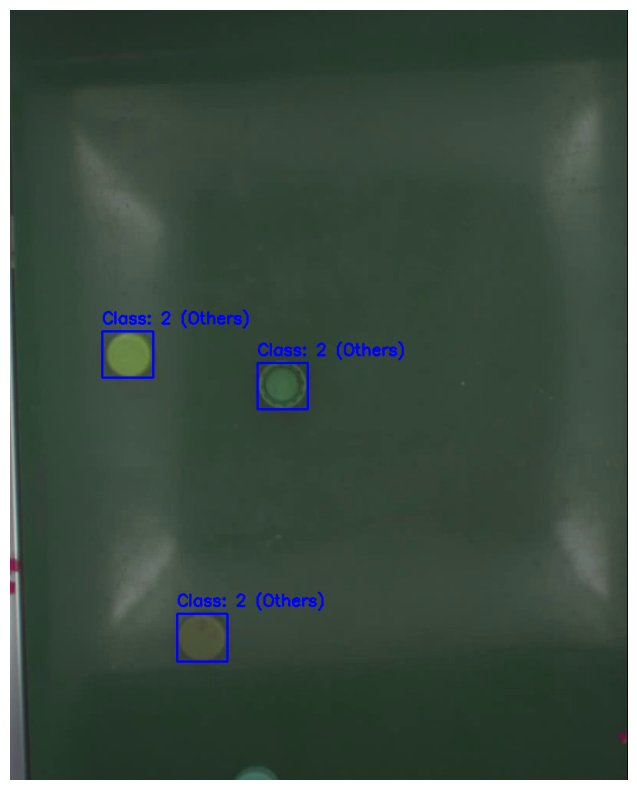


VERIFYING IMAGE: raw-250110_dc_s001_b2_15.jpg
  > Box [346,67] | HSV: [ 56 111  94] | Assigned: Class: 2 (Others)
  > Box [574,459] | HSV: [61 78 72] | Assigned: Class: 2 (Others)
  > Box [482,374] | HSV: [ 67 112  96] | Assigned: Class: 2 (Others)
  > Box [423,424] | HSV: [ 45 120  96] | Assigned: Class: 2 (Others)
  > Box [328,785] | HSV: [ 47 110  81] | Assigned: Class: 2 (Others)
  > Box [391,178] | HSV: [ 37  70 106] | Assigned: Class: 2 (Others)
  > Box [590,253] | HSV: [ 80 108 102] | Assigned: Class: 2 (Others)


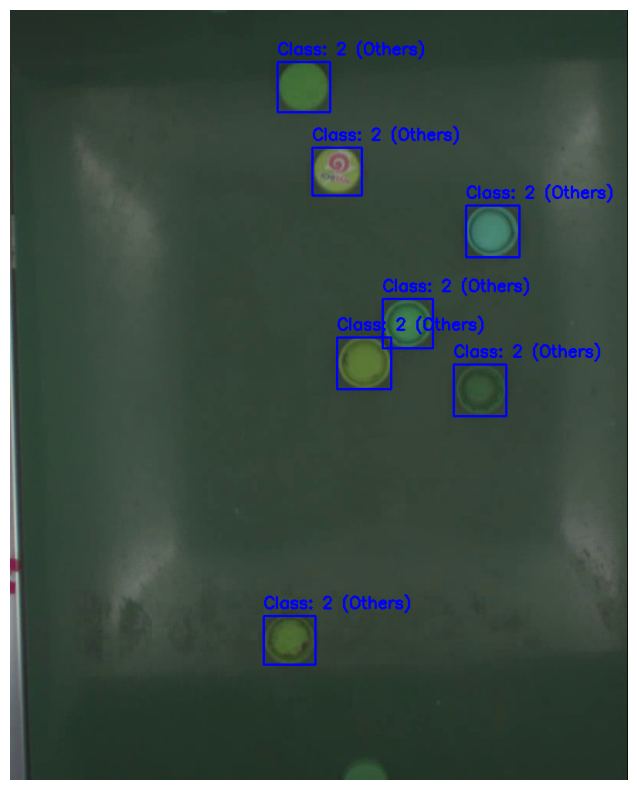


VERIFYING IMAGE: raw-250110_dc_s001_b2_3.jpg
  > Box [261,90] | HSV: [ 78  95 105] | Assigned: Class: 2 (Others)
  > Box [477,130] | HSV: [ 47 107  93] | Assigned: Class: 2 (Others)
  > Box [416,837] | HSV: [ 79 104 101] | Assigned: Class: 2 (Others)
  > Box [325,598] | HSV: [ 62 107  93] | Assigned: Class: 2 (Others)
  > Box [147,432] | HSV: [ 59 100 102] | Assigned: Class: 2 (Others)
  > Box [233,714] | HSV: [ 44  34 114] | Assigned: Class: 2 (Others)
  > Box [302,208] | HSV: [65 89 95] | Assigned: Class: 2 (Others)


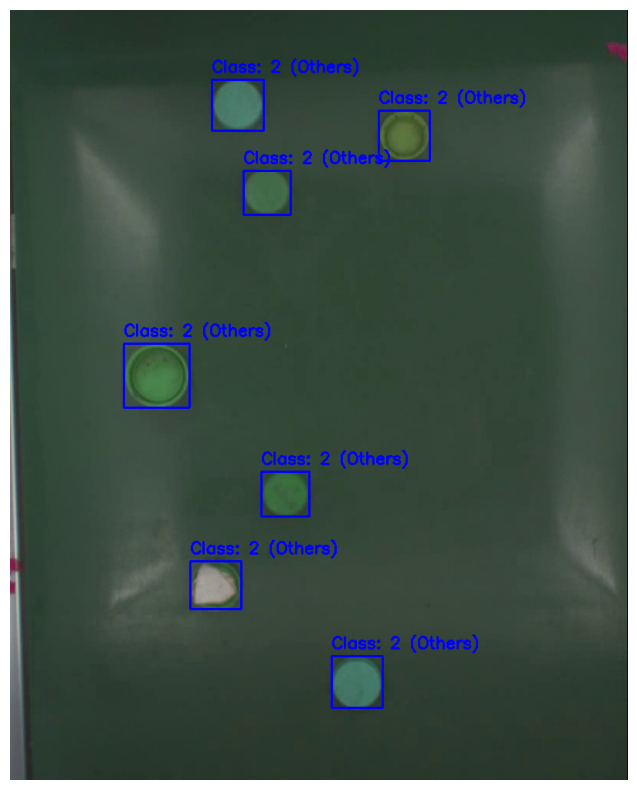


VERIFYING IMAGE: raw-250110_dc_s001_b3_2.jpg
  > Box [467,458] | HSV: [ 23 102 128] | Assigned: Class: 2 (Others)
  > Box [248,783] | HSV: [ 21 110 114] | Assigned: Class: 2 (Others)
  > Box [600,75] | HSV: [ 17 105 119] | Assigned: Class: 2 (Others)
  > Box [514,195] | HSV: [ 20  97 124] | Assigned: Class: 2 (Others)
  > Box [290,184] | HSV: [ 18 104 150] | Assigned: Class: 2 (Others)
  > Box [210,356] | HSV: [ 20  98 174] | Assigned: Class: 2 (Others)
  > Box [94,83] | HSV: [ 21 101 124] | Assigned: Class: 2 (Others)
  > Box [113,606] | HSV: [ 17 108 125] | Assigned: Class: 2 (Others)
  > Box [592,434] | HSV: [ 17 104 145] | Assigned: Class: 2 (Others)


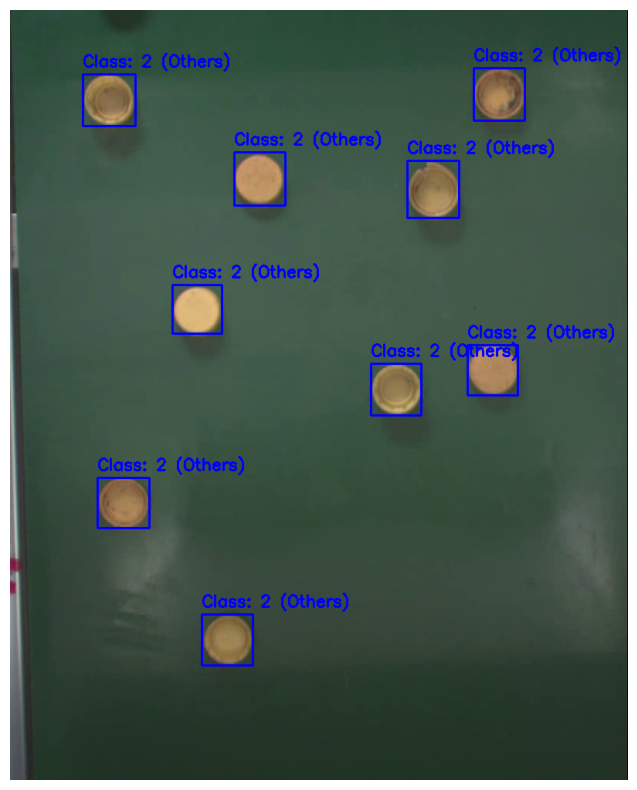


VERIFYING IMAGE: raw-250110_dc_s001_b3_3.jpg
  > Box [431,375] | HSV: [ 28  74 135] | Assigned: Class: 2 (Others)
  > Box [426,494] | HSV: [ 13  95 142] | Assigned: Class: 2 (Others)
  > Box [231,647] | HSV: [ 20 107 133] | Assigned: Class: 2 (Others)
  > Box [80,431] | HSV: [ 21 106 135] | Assigned: Class: 2 (Others)
  > Box [166,295] | HSV: [ 21  94 127] | Assigned: Class: 2 (Others)
  > Box [343,192] | HSV: [ 20 109 148] | Assigned: Class: 2 (Others)
  > Box [318,11] | HSV: [ 17 111 122] | Assigned: Class: 2 (Others)
  > Box [168,0] | HSV: [ 20 118 147] | Assigned: Class: 2 (Others)


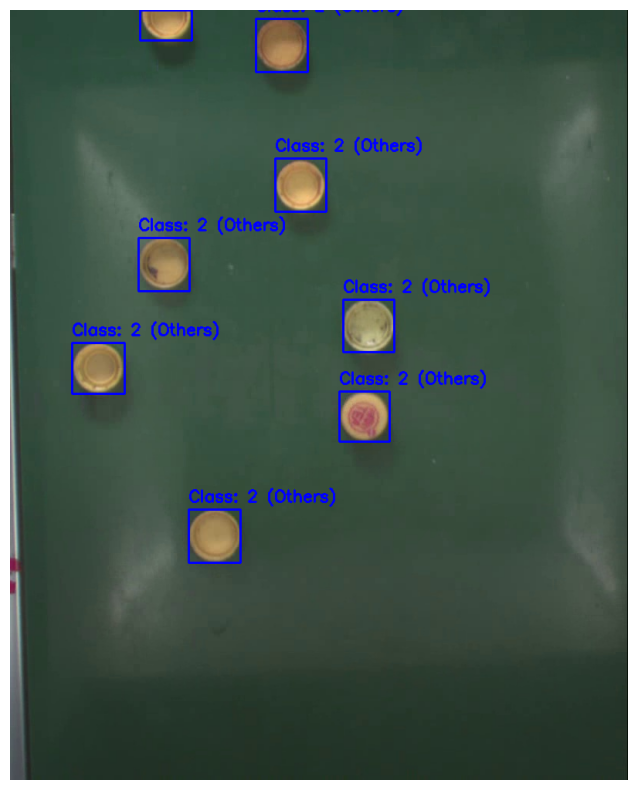


VERIFYING IMAGE: raw-250110_dc_s001_b3_4.jpg
  > Box [595,131] | HSV: [ 22 104 128] | Assigned: Class: 2 (Others)
  > Box [355,306] | HSV: [ 17 117 142] | Assigned: Class: 2 (Others)
  > Box [308,206] | HSV: [ 17 112 157] | Assigned: Class: 2 (Others)
  > Box [264,48] | HSV: [ 20 107 124] | Assigned: Class: 2 (Others)
  > Box [211,726] | HSV: [ 22  87 106] | Assigned: Class: 2 (Others)
  > Box [484,645] | HSV: [ 23 102 113] | Assigned: Class: 2 (Others)
  > Box [308,518] | HSV: [ 17 118 138] | Assigned: Class: 2 (Others)
  > Box [529,858] | HSV: [ 23 115 102] | Assigned: Class: 2 (Others)
  > Box [527,444] | HSV: [ 18 113 135] | Assigned: Class: 2 (Others)
  > Box [403,203] | HSV: [ 22 103 124] | Assigned: Class: 2 (Others)


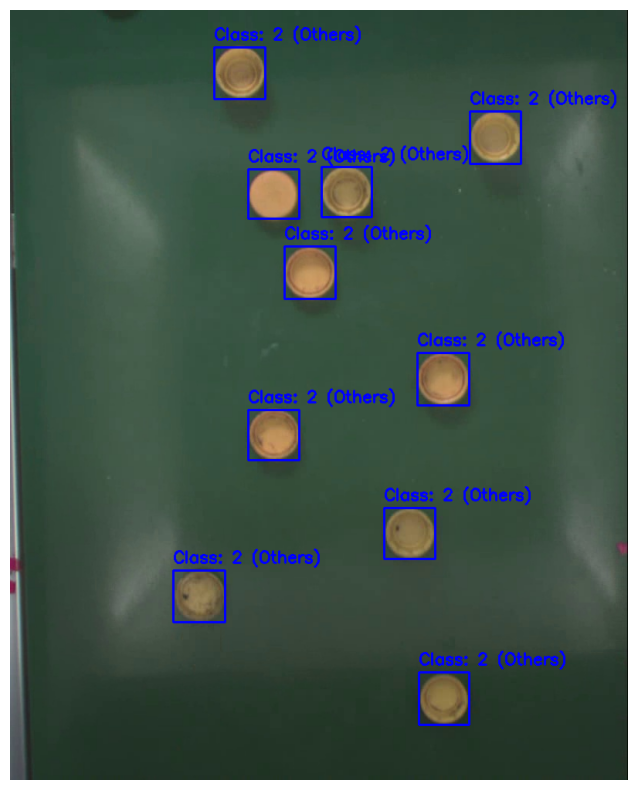


VERIFYING IMAGE: raw-250110_dc_s001_b4_1.jpg
  > Box [366,801] | HSV: [ 92 102  80] | Assigned: Class: 0 (Light Blue)
  > Box [549,466] | HSV: [ 99  77 120] | Assigned: Class: 0 (Light Blue)
  > Box [443,633] | HSV: [ 99  69 103] | Assigned: Class: 0 (Light Blue)
  > Box [183,417] | HSV: [100  82 118] | Assigned: Class: 0 (Light Blue)
  > Box [229,605] | HSV: [90 37 83] | Assigned: Class: 0 (Light Blue)


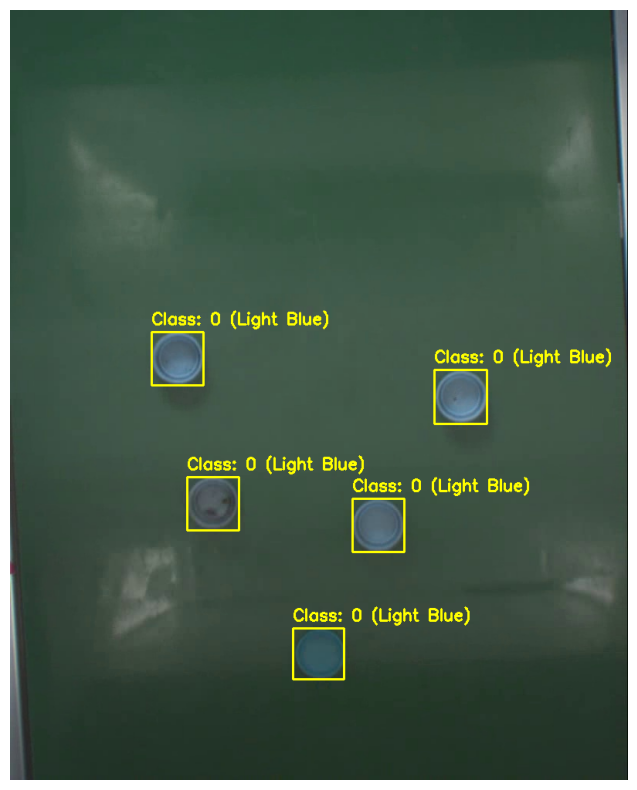


VERIFYING IMAGE: raw-250110_dc_s001_b4_2.jpg
  > Box [544,310] | HSV: [ 99  80 124] | Assigned: Class: 0 (Light Blue)
  > Box [175,258] | HSV: [100  84 121] | Assigned: Class: 0 (Light Blue)
  > Box [219,448] | HSV: [96 43 95] | Assigned: Class: 0 (Light Blue)
  > Box [360,647] | HSV: [ 93 116  97] | Assigned: Class: 0 (Light Blue)
  > Box [119,907] | HSV: [91 87 70] | Assigned: Class: 0 (Light Blue)
  > Box [435,477] | HSV: [ 99  82 121] | Assigned: Class: 0 (Light Blue)


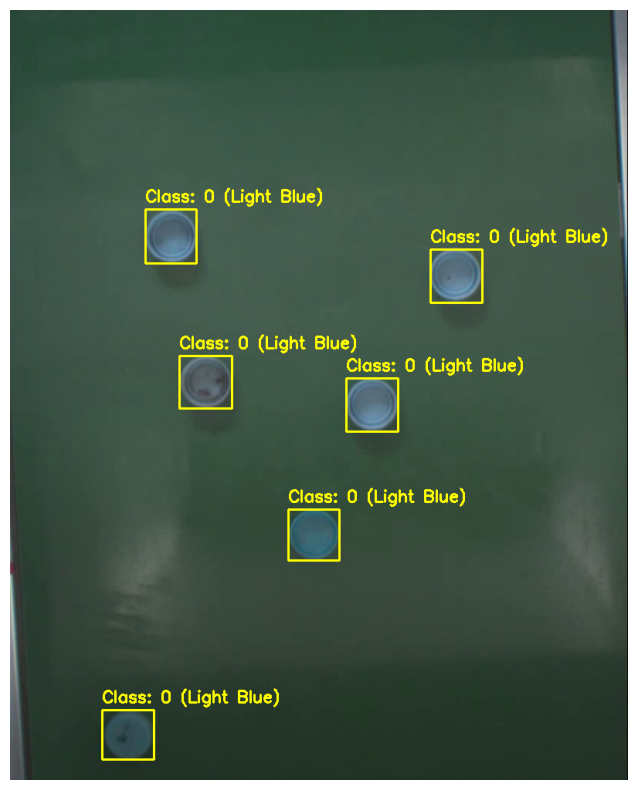


VERIFYING IMAGE: raw-250110_dc_s001_b4_3.jpg
  > Box [163,67] | HSV: [100  91 118] | Assigned: Class: 0 (Light Blue)
  > Box [425,287] | HSV: [ 99  84 125] | Assigned: Class: 0 (Light Blue)
  > Box [350,458] | HSV: [ 94 136 116] | Assigned: Class: 0 (Light Blue)
  > Box [208,258] | HSV: [95 44 98] | Assigned: Class: 0 (Light Blue)
  > Box [533,116] | HSV: [ 99  80 121] | Assigned: Class: 0 (Light Blue)
  > Box [111,725] | HSV: [93 83 92] | Assigned: Class: 0 (Light Blue)
  > Box [432,842] | HSV: [ 98 110  74] | Assigned: Class: 0 (Light Blue)


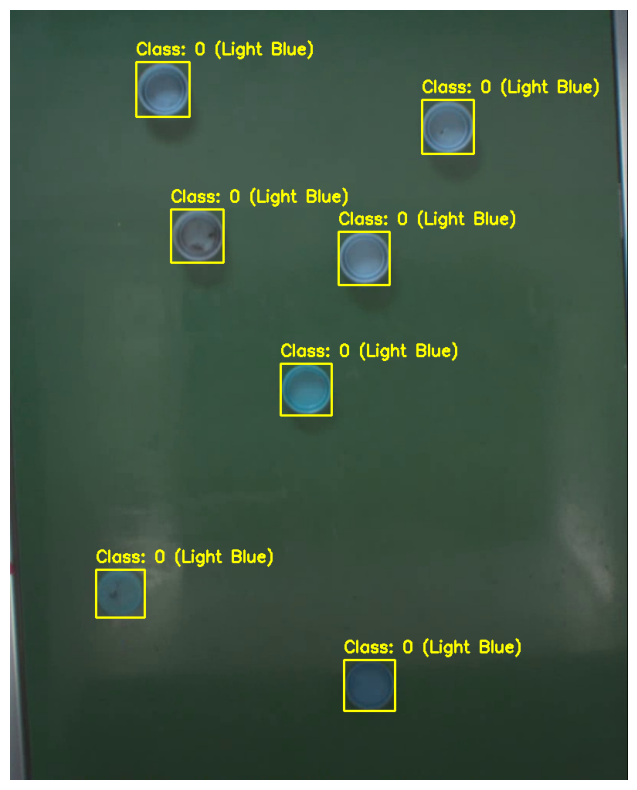


VERIFYING IMAGE: raw-250110_dc_s001_b5_2.jpg
  > Box [290,573] | HSV: [105  86  71] | Assigned: Class: 1 (Dark Blue)
  > Box [468,307] | HSV: [102  90  74] | Assigned: Class: 1 (Dark Blue)
  > Box [375,821] | HSV: [105  78  59] | Assigned: Class: 1 (Dark Blue)
  > Box [211,285] | HSV: [104 108  80] | Assigned: Class: 1 (Dark Blue)
  > Box [344,440] | HSV: [102  91  76] | Assigned: Class: 1 (Dark Blue)


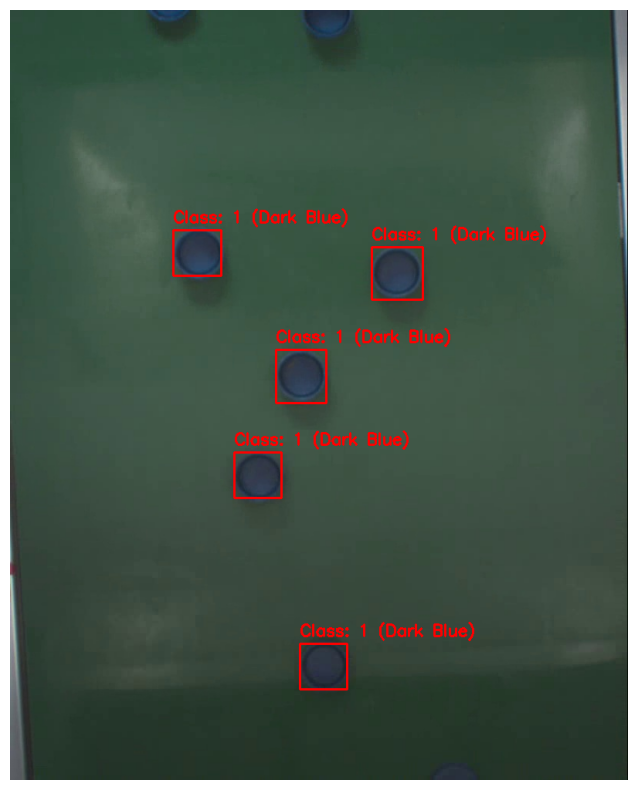


VERIFYING IMAGE: raw-250110_dc_s001_b5_3.jpg
  > Box [278,363] | HSV: [104  95  78] | Assigned: Class: 1 (Dark Blue)
  > Box [335,233] | HSV: [104  97  79] | Assigned: Class: 1 (Dark Blue)
  > Box [200,69] | HSV: [102 121  78] | Assigned: Class: 1 (Dark Blue)
  > Box [532,769] | HSV: [102  59  65] | Assigned: Class: 1 (Dark Blue)
  > Box [364,609] | HSV: [104  84  67] | Assigned: Class: 1 (Dark Blue)
  > Box [457,93] | HSV: [103  95  75] | Assigned: Class: 1 (Dark Blue)
  > Box [249,936] | HSV: [110 146  63] | Assigned: Class: 1 (Dark Blue)


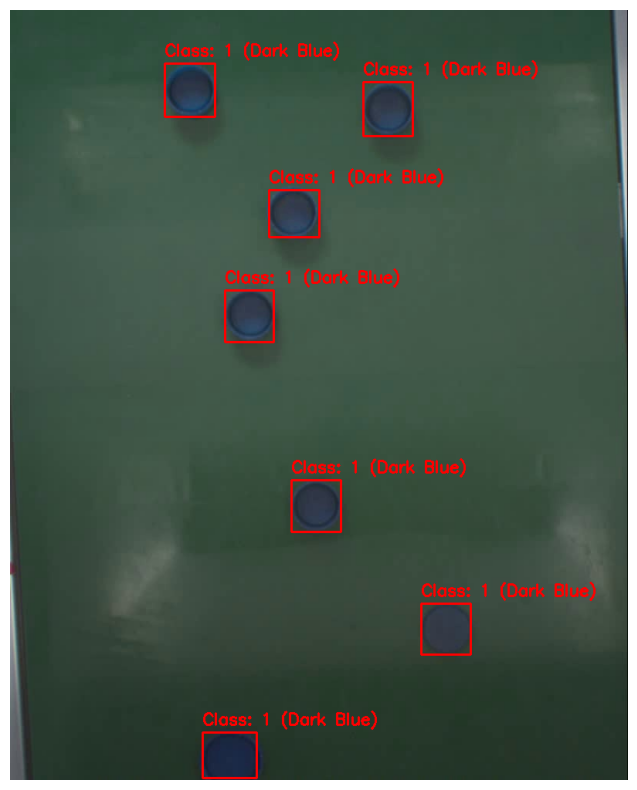


VERIFYING IMAGE: raw-250110_dc_s001_b5_5.jpg
  > Box [472,458] | HSV: [103  99  75] | Assigned: Class: 1 (Dark Blue)
  > Box [586,837] | HSV: [102  54  61] | Assigned: Class: 1 (Dark Blue)
  > Box [500,112] | HSV: [103  86  89] | Assigned: Class: 1 (Dark Blue)
  > Box [209,276] | HSV: [105 145  97] | Assigned: Class: 1 (Dark Blue)
  > Box [271,792] | HSV: [102  73  59] | Assigned: Class: 1 (Dark Blue)


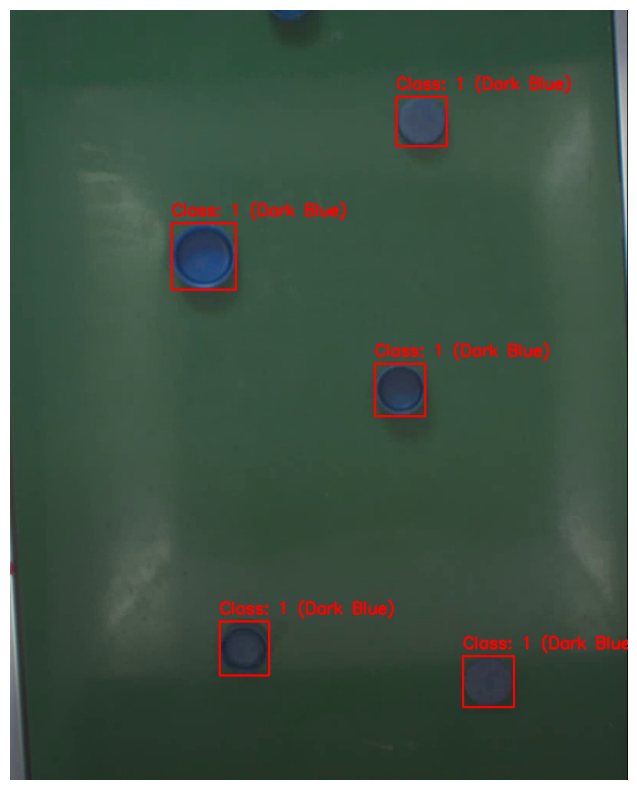

Verification completed.


In [58]:
data_dir = './bottle_cap_dataset/sample/'
image_files = sorted(glob.glob(os.path.join(data_dir, '*.jpg')))

if not image_files:
    print(f"Error: No .jpg files found in {data_dir}")
else:
    print(f"Starting verification for {len(image_files)} images...\n")

    for sample_image_path in image_files:
        sample_label_name = os.path.splitext(os.path.basename(sample_image_path))[0] + '.txt'
        sample_label_path = os.path.join(data_dir, sample_label_name)

        plot_with_new_labels(sample_image_path, sample_label_path)

print("Verification completed.")


## Create the folder for the processed folder and

In [60]:
# ==========================================
# CONFIGURATION
# ==========================================
INPUT_DIR = './bottle_cap_dataset/sample/'
OUTPUT_RELABELED_DIR = './relabeled_data/'

# Replace these values with results from your analysis
LIGHT_BLUE_RANGE = (90, 100)
DARK_BLUE_RANGE  = (101, 120)


def get_hsv_mean(crop):
    mean_bgr = np.mean(crop, axis=(0, 1))
    mean_bgr_pixel = np.uint8([[mean_bgr]])
    mean_hsv = cv2.cvtColor(mean_bgr_pixel, cv2.COLOR_BGR2HSV)[0][0]
    return mean_hsv


def determine_class(h_val):
    if LIGHT_BLUE_RANGE[0] <= h_val <= LIGHT_BLUE_RANGE[1]:
        return 0  # Light Blue
    elif DARK_BLUE_RANGE[0] <= h_val <= DARK_BLUE_RANGE[1]:
        return 1  # Dark Blue
    return 2      # Others


def run_relabeling():
    # Prepare output directory
    if os.path.exists(OUTPUT_RELABELED_DIR):
        shutil.rmtree(OUTPUT_RELABELED_DIR)

    os.makedirs(os.path.join(OUTPUT_RELABELED_DIR, 'images'), exist_ok=True)
    os.makedirs(os.path.join(OUTPUT_RELABELED_DIR, 'labels'), exist_ok=True)

    image_files = glob.glob(os.path.join(INPUT_DIR, '*.jpg'))
    print(f"--- Step 1: Processing {len(image_files)} images for relabeling ---")

    for img_path in image_files:
        filename = os.path.basename(img_path)
        base_name = os.path.splitext(filename)[0]
        label_path_src = os.path.join(INPUT_DIR, base_name + '.txt')

        shutil.copy(img_path, os.path.join(OUTPUT_RELABELED_DIR, 'images', filename))

        new_labels = []
        img = cv2.imread(img_path)
        if img is None:
            continue

        h_img, w_img, _ = img.shape

        if os.path.exists(label_path_src):
            with open(label_path_src, 'r') as f:
                lines = f.readlines()

            for line in lines:
                parts = line.strip().split()
                if len(parts) != 5:
                    continue

                x_c, y_c, w, h = map(float, parts[1:])

                x1 = int((x_c - w / 2) * w_img)
                y1 = int((y_c - h / 2) * h_img)
                x2 = int((x_c + w / 2) * w_img)
                y2 = int((y_c + h / 2) * h_img)

                crop = img[max(0, y1):min(h_img, y2), max(0, x1):min(w_img, x2)]
                if crop.size == 0:
                    continue

                h_val = get_hsv_mean(crop)[0]
                new_class = determine_class(h_val)

                new_labels.append(f"{new_class} {x_c} {y_c} {w} {h}")

        with open(os.path.join(OUTPUT_RELABELED_DIR, 'labels', base_name + '.txt'), 'w') as f:
            f.write('\n'.join(new_labels))

    print(f"✔ Success! Relabeled data saved to: {OUTPUT_RELABELED_DIR}")
    print("You can now continue to Step 2 (Augmentation).")


# Run the relabeling process
run_relabeling()


--- Step 1: Processing 12 images for relabeling ---
✔ Success! Relabeled data saved to: ./relabeled_data/
You can now continue to Step 2 (Augmentation).


In [61]:
# ==========================================
# AUGMENTATION CONFIGURATION
# ==========================================
INPUT_RELABELED_DIR = './relabeled_data/'
OUTPUT_AUGMENTED_DIR = './augmented_data/'
NUM_AUGMENTATIONS = 20

# Augmentation Pipeline
transform = A.Compose(
    [
        A.HorizontalFlip(p=0.5),
        A.VerticalFlip(p=0.5),
        A.Rotate(limit=30, p=0.7),
        A.RandomScale(scale_limit=0.2, p=0.5),
        A.RandomBrightnessContrast(p=0.5),
        A.HueSaturationValue(hue_shift_limit=5, sat_shift_limit=30, val_shift_limit=20, p=0.5),
        A.OneOf(
            [
                A.Blur(blur_limit=3, p=1),
                A.GaussNoise(p=1),
                A.MedianBlur(blur_limit=3, p=1)
            ],
            p=0.3,
        ),
    ],
    bbox_params=A.BboxParams(
        format='yolo',
        label_fields=['class_labels'],
        min_visibility=0.3
    )
)


def run_augmentation():
    if os.path.exists(OUTPUT_AUGMENTED_DIR):
        shutil.rmtree(OUTPUT_AUGMENTED_DIR)

    os.makedirs(os.path.join(OUTPUT_AUGMENTED_DIR, 'images'), exist_ok=True)
    os.makedirs(os.path.join(OUTPUT_AUGMENTED_DIR, 'labels'), exist_ok=True)

    image_files = glob.glob(os.path.join(INPUT_RELABELED_DIR, 'images', '*.jpg'))
    print(f"--- Step 2: Starting augmentation from {len(image_files)} relabeled images ---")

    count = 0

    for img_path in image_files:
        base_name = os.path.splitext(os.path.basename(img_path))[0]
        label_path = os.path.join(INPUT_RELABELED_DIR, 'labels', base_name + '.txt')

        image = cv2.imread(img_path)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

        bboxes = []
        class_labels = []

        if os.path.exists(label_path):
            with open(label_path, 'r') as f:
                for line in f:
                    parts = line.strip().split()
                    cls = int(parts[0])
                    coords = list(map(float, parts[1:]))
                    bboxes.append(coords)
                    class_labels.append(cls)

        save_augmented_data(image, bboxes, class_labels, f"{base_name}_orig")
        count += 1

        for i in range(NUM_AUGMENTATIONS):
            try:
                aug = transform(image=image, bboxes=bboxes, class_labels=class_labels)
                if len(aug['bboxes']) > 0:
                    save_augmented_data(
                        aug['image'],
                        aug['bboxes'],
                        aug['class_labels'],
                        f"{base_name}_aug_{i}"
                    )
                    count += 1
            except Exception:
                pass

    print(f"✔ Augmentation complete. Total {count} images saved to: {OUTPUT_AUGMENTED_DIR}")


def save_augmented_data(img_rgb, bboxes, classes, filename):
    img_bgr = cv2.cvtColor(img_rgb, cv2.COLOR_RGB2BGR)
    cv2.imwrite(os.path.join(OUTPUT_AUGMENTED_DIR, 'images', filename + '.jpg'), img_bgr)

    with open(os.path.join(OUTPUT_AUGMENTED_DIR, 'labels', filename + '.txt'), 'w') as f:
        for box, cls in zip(bboxes, classes):
            box = [max(0.0, min(1.0, b)) for b in box]
            f.write(f"{cls} {box[0]:.6f} {box[1]:.6f} {box[2]:.6f} {box[3]:.6f}\n")

run_augmentation()

--- Step 2: Starting augmentation from 12 relabeled images ---
✔ Augmentation complete. Total 252 images saved to: ./augmented_data/


In [63]:
folder = "/content/augmented_data/images"
files = os.listdir(folder)

image_extensions = (".jpg", ".jpeg", ".png", ".bmp", ".gif", ".webp")
images = [f for f in files if f.lower().endswith(image_extensions)]

print("Total files:", len(files))
print("Total images:", len(images))


Total files: 252
Total images: 252


### Checking the base name of all augmented images.

In [64]:
import os
import glob

# Folder where augmented images are stored
AUG_IMG_DIR = './augmented_data/images/'

def list_available_patterns():
    files = glob.glob(os.path.join(AUG_IMG_DIR, '*_orig.jpg'))

    if not files:
        print("No files found in the augmented_data folder.")
        return

    print("Available FILE CODES (Patterns):\n")
    print("-" * 40)

    for file_path in sorted(files):
        filename = os.path.basename(file_path)
        pattern = filename.replace('_orig.jpg', '')
        short_pattern = pattern.split('_s001_')[-1]

        print(f"Full Name: {pattern}")
        print(f"Short ID : {short_pattern}")
        print("-" * 40)

list_available_patterns()

Available FILE CODES (Patterns):

----------------------------------------
Full Name: raw-250110_dc_s001_b2_15
Short ID : b2_15
----------------------------------------
Full Name: raw-250110_dc_s001_b2_1
Short ID : b2_1
----------------------------------------
Full Name: raw-250110_dc_s001_b2_3
Short ID : b2_3
----------------------------------------
Full Name: raw-250110_dc_s001_b3_2
Short ID : b3_2
----------------------------------------
Full Name: raw-250110_dc_s001_b3_3
Short ID : b3_3
----------------------------------------
Full Name: raw-250110_dc_s001_b3_4
Short ID : b3_4
----------------------------------------
Full Name: raw-250110_dc_s001_b4_1
Short ID : b4_1
----------------------------------------
Full Name: raw-250110_dc_s001_b4_2
Short ID : b4_2
----------------------------------------
Full Name: raw-250110_dc_s001_b4_3
Short ID : b4_3
----------------------------------------
Full Name: raw-250110_dc_s001_b5_2
Short ID : b5_2
----------------------------------------
Ful

🚀 Starting batch verification for 12 image groups...

📂 Group: raw-250110_dc_s001_b2_15 (Total variations in folder: 21)


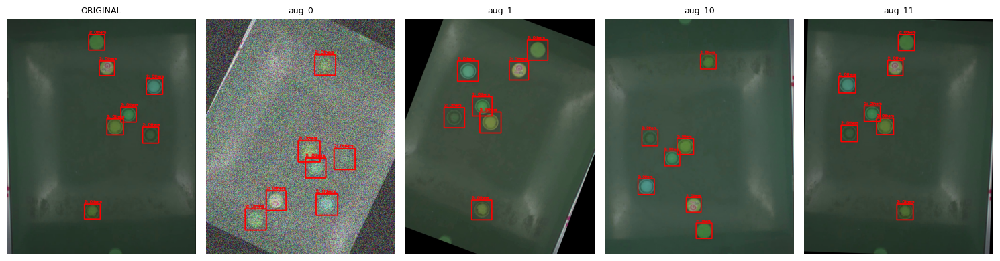

--------------------------------------------------------------------------------
📂 Group: raw-250110_dc_s001_b2_1 (Total variations in folder: 42)


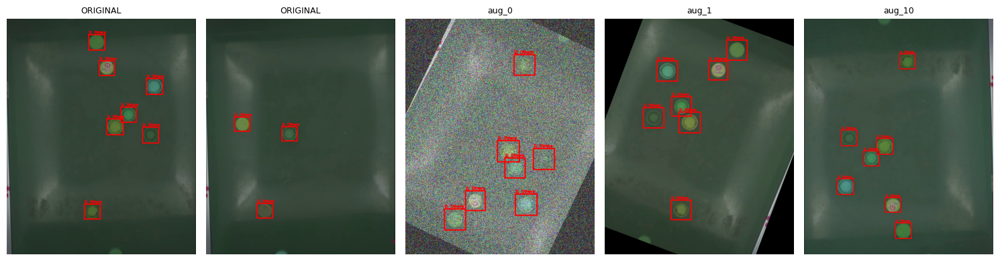

--------------------------------------------------------------------------------
📂 Group: raw-250110_dc_s001_b2_3 (Total variations in folder: 21)


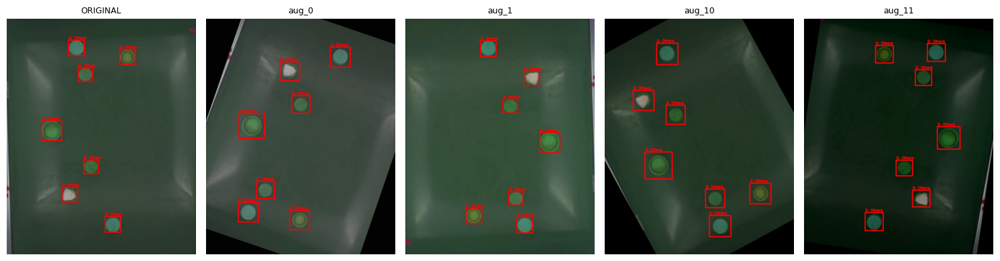

--------------------------------------------------------------------------------
📂 Group: raw-250110_dc_s001_b3_2 (Total variations in folder: 21)


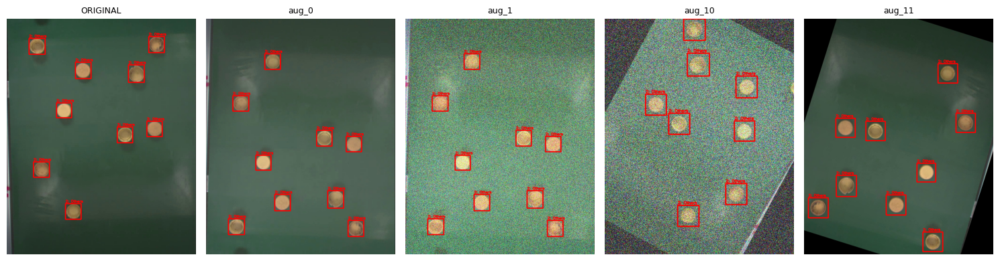

--------------------------------------------------------------------------------
📂 Group: raw-250110_dc_s001_b3_3 (Total variations in folder: 21)


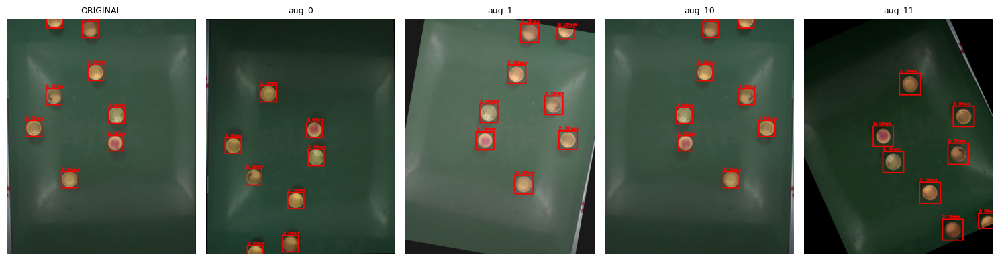

--------------------------------------------------------------------------------
📂 Group: raw-250110_dc_s001_b3_4 (Total variations in folder: 21)


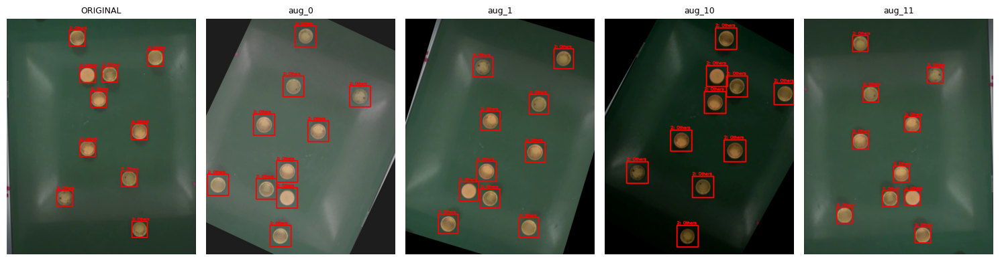

--------------------------------------------------------------------------------
📂 Group: raw-250110_dc_s001_b4_1 (Total variations in folder: 21)


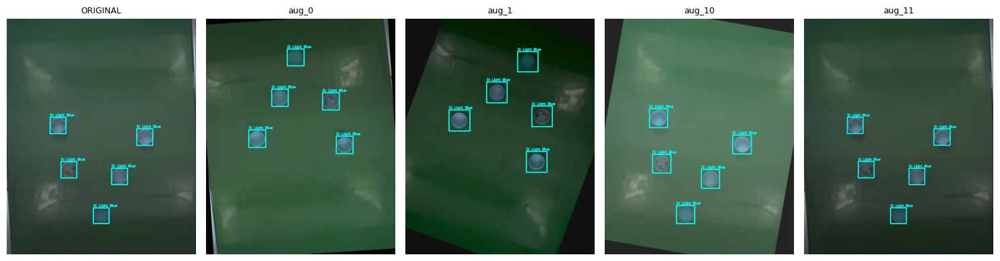

--------------------------------------------------------------------------------
📂 Group: raw-250110_dc_s001_b4_2 (Total variations in folder: 21)


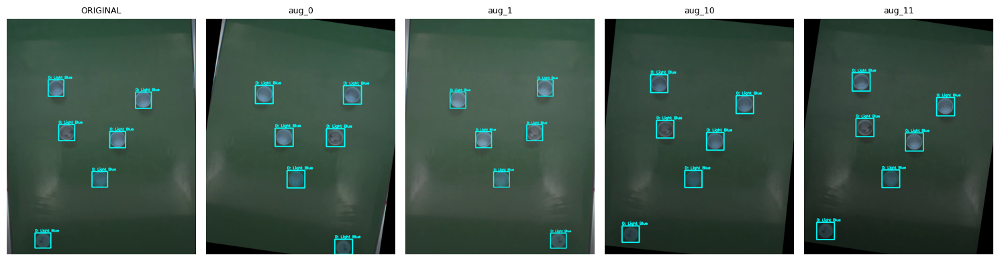

--------------------------------------------------------------------------------
📂 Group: raw-250110_dc_s001_b4_3 (Total variations in folder: 21)


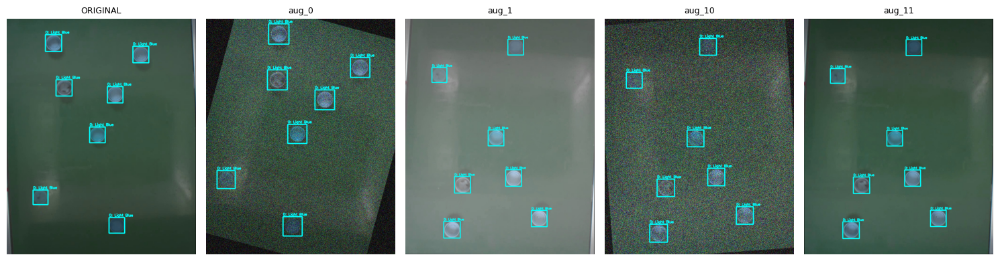

--------------------------------------------------------------------------------
📂 Group: raw-250110_dc_s001_b5_2 (Total variations in folder: 21)


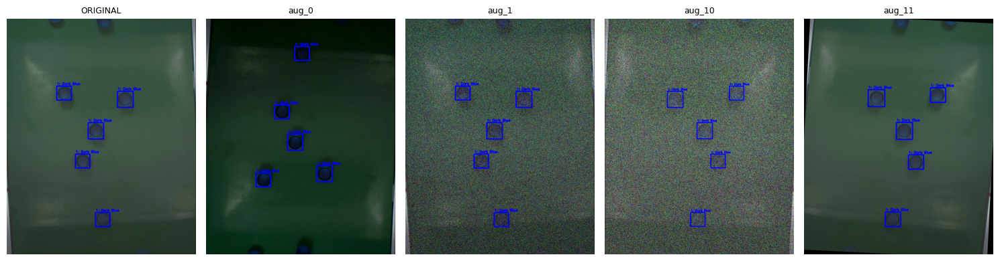

--------------------------------------------------------------------------------
📂 Group: raw-250110_dc_s001_b5_3 (Total variations in folder: 21)


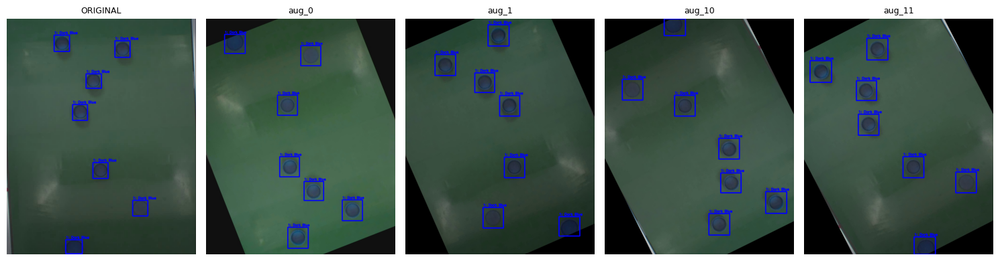

--------------------------------------------------------------------------------
📂 Group: raw-250110_dc_s001_b5_5 (Total variations in folder: 21)


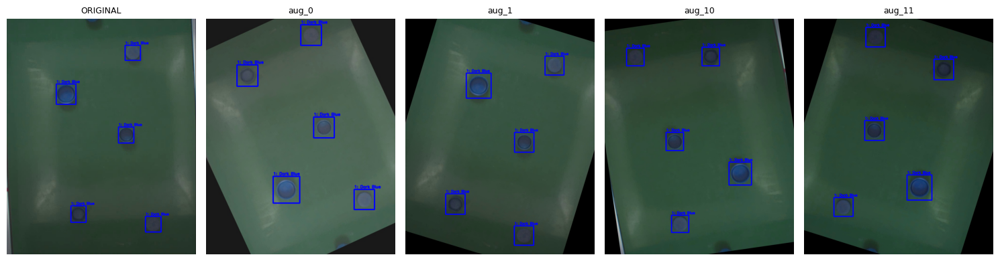

--------------------------------------------------------------------------------


In [65]:
import os
import glob
import cv2
import matplotlib.pyplot as plt

# ==========================================
# CONFIGURATION
# ==========================================
AUG_IMG_DIR = './augmented_data/images/'
AUG_LBL_DIR = './augmented_data/labels/'
SAMPLES_PER_GROUP = 5  # Number of slots per row

def verify_all_augmentations():
    orig_files = sorted(glob.glob(os.path.join(AUG_IMG_DIR, '*_orig.jpg')))

    if not orig_files:
        print("❌ No '_orig.jpg' files found.")
        return

    print(f"🚀 Starting batch verification for {len(orig_files)} image groups...\n")

    for orig_path in orig_files:
        filename = os.path.basename(orig_path)
        base_pattern = filename.replace('_orig.jpg', '')

        group_files = sorted(glob.glob(os.path.join(AUG_IMG_DIR, f"{base_pattern}*.jpg")))

        current_orig = [f for f in group_files if "_orig" in f]
        current_augs = [f for f in group_files if "_aug" in f]

        display_files = (current_orig + current_augs)[:SAMPLES_PER_GROUP]
        actual_count = len(display_files)
        if actual_count == 0:
            continue

        print(f"📂 Group: {base_pattern} (Total variations in folder: {len(group_files)})")

        plt.figure(figsize=(3 * actual_count, 4))

        for i, img_path in enumerate(display_files):
            fname = os.path.basename(img_path)
            lbl_name = os.path.splitext(fname)[0] + '.txt'
            lbl_path = os.path.join(AUG_LBL_DIR, lbl_name)

            img = cv2.imread(img_path)
            if img is None:
                continue
            img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
            h_img, w_img, _ = img.shape

            if os.path.exists(lbl_path):
                with open(lbl_path, 'r') as f:
                    for line in f:
                        parts = line.strip().split()
                        try:
                            cls_id = int(float(parts[0]))
                        except ValueError:
                            continue

                        x, y, w, h = map(float, parts[1:])
                        x1 = int((x - w/2) * w_img)
                        y1 = int((y - h/2) * h_img)
                        x2 = int((x + w/2) * w_img)
                        y2 = int((y + h/2) * h_img)

                        if cls_id == 0: color = (0, 255, 255); txt = "0: Light Blue"
                        elif cls_id == 1: color = (0, 0, 255); txt = "1: Dark Blue"
                        else: color = (255, 0, 0); txt = "2: Others"

                        cv2.rectangle(img, (x1, y1), (x2, y2), color, 3)
                        cv2.putText(img, txt, (x1, y1-5), cv2.FONT_HERSHEY_SIMPLEX, 0.5, color, 2)

            plt.subplot(1, actual_count, i+1)
            plt.imshow(img)

            if "_orig" in fname:
                title = "ORIGINAL"
            else:
                try:
                    title = fname.split('_')[-2] + "_" + fname.split('_')[-1].replace('.jpg','')
                except:
                    title = "Augmented"

            plt.title(title, fontsize=9)
            plt.axis('off')

        plt.tight_layout()
        plt.show()
        print("-" * 80)

# Run verification
verify_all_augmentations()

In [66]:
# ==========================================
# SPLITTING CONFIGURATION
# ==========================================
INPUT_AUGMENTED_DIR = './augmented_data/'
FINAL_DATASET_DIR = './final_dataset/'

def run_splitting():
    print(f"--- Step 3: Splitting data into Train/Validation ---")

    splitfolders.ratio(
        INPUT_AUGMENTED_DIR,
        output=FINAL_DATASET_DIR,
        seed=1337,
        ratio=(0.8, 0.2),
        group_prefix=None,
        move=False  # Set to True to move files instead of copying
    )

    print(f"✅ Done! Dataset is ready for training.")
    print(f"Training dataset location: {FINAL_DATASET_DIR}")

run_splitting()

--- Step 3: Splitting data into Train/Validation ---


Copying files: 504 files [00:00, 987.57 files/s]

✅ Done! Dataset is ready for training.
Training dataset location: ./final_dataset/


## TIme to Train the Model

### Create Data.yaml

In [67]:
import yaml
import os

# Get absolute path for the final dataset folder
# YOLO prefers absolute paths
dataset_path = os.path.abspath('./final_dataset')

data_yaml = {
    'path': dataset_path,       # Root folder
    'train': 'train/images',    # Training images folder (relative to root)
    'val': 'val/images',        # Validation images folder
    'nc': 3,                     # Number of classes
    'names': ['Light Blue', 'Dark Blue', 'Others']  # Class names in order
}

# Save to data.yaml
with open('data.yaml', 'w') as f:
    yaml.dump(data_yaml, f)

print("File 'data.yaml' created successfully!")
print(f"Dataset path: {dataset_path}")


File 'data.yaml' created successfully!
Dataset path: /content/final_dataset


## 3. Model Selection: Why YOLOv8 Nano?

I selected **YOLOv8 Nano (v8n)** as the architecture for this task. This decision is driven strictly by the **inference time constraint (<10ms)** on the Raspberry Pi 5.

**Justification:**
* **Efficiency:** YOLOv8n has the fewest parameters (~3.2M) and FLOPs compared to larger variants (s/m/l), making it the only viable candidate for real-time CPU/NPU inference on edge devices.
* **Accuracy-Speed Tradeoff:** Despite its small size, v8n maintains competitive mAP scores for detecting distinct objects like bottle caps.

In [31]:
# Load YOLOv8 Nano model (lightweight)
model_10 = YOLO('yolov8n.pt')

print("🚀 Starting training...")

# Train the model
results = model_10.train(
    data='data.yaml',                 # Path to dataset YAML
    epochs=10,                        # Number of training epochs
    imgsz=320,                        # Image size
    batch=8,                          # Batch size (adjust based on GPU)
    project='bottle_cap_project_10_epoch',  # Output folder
    name='yolov8n_run',               # Sub-folder for this run
    exist_ok=True,                     # Overwrite if folder exists
    plots=True                         # Save training plots (loss, confusion matrix, etc.)
)

🚀 Mulai Training...
Ultralytics 8.3.229 🚀 Python-3.12.12 torch-2.8.0+cu126 CPU (Intel Xeon CPU @ 2.20GHz)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=8, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=data.yaml, degrees=0.0, deterministic=True, device=cpu, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=10, erasing=0.4, exist_ok=True, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=320, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolov8n.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=yolov8n_run, nbs=64, nms=False, opset=None, optimize=False, optimizer=auto, overlap_mask=True, patience=100, perspective=0.0, plots=True,

In [25]:
# Load YOLOv8 Nano model (lightweight)
model_12 = YOLO('yolov8n.pt')

print("🚀 Starting training...")

# Train the model
results = model_12.train(
    data='data.yaml',                  # Path to dataset YAML
    epochs=12,                         # Number of training epochs
    imgsz=320,                         # Image size
    batch=8,                            # Batch size (adjust for GPU)
    project='bottle_cap_project_12_epoch',  # Output folder
    name='yolov8n_run',                # Sub-folder name for this run
    exist_ok=True,                      # Overwrite folder if it exists
    plots=True                          # Save training plots (loss, confusion matrix, etc.)
)

🚀 Mulai Training...
Ultralytics 8.3.229 🚀 Python-3.12.12 torch-2.8.0+cu126 CPU (Intel Xeon CPU @ 2.20GHz)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=8, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=data.yaml, degrees=0.0, deterministic=True, device=cpu, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=12, erasing=0.4, exist_ok=True, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=320, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolov8n.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=yolov8n_run, nbs=64, nms=False, opset=None, optimize=False, optimizer=auto, overlap_mask=True, patience=100, perspective=0.0, plots=True,

In [26]:
# Load YOLOv8 Nano model (lightweight)
model_15 = YOLO('yolov8n.pt')

print("🚀 Starting training...")

# Train the model
results = model_15.train(
    data='data.yaml',                  # Path to dataset YAML
    epochs=15,                         # Number of training epochs
    imgsz=320,                         # Image size
    batch=8,                           # Batch size (adjust based on GPU)
    project='bottle_cap_project_15_epoch',  # Output folder
    name='yolov8n_run',                # Sub-folder name for this run
    exist_ok=True,                     # Overwrite folder if it exists
    plots=True                          # Save training plots (loss, confusion matrix, etc.)
)

🚀 Mulai Training...
Ultralytics 8.3.229 🚀 Python-3.12.12 torch-2.8.0+cu126 CPU (Intel Xeon CPU @ 2.20GHz)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=8, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=data.yaml, degrees=0.0, deterministic=True, device=cpu, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=15, erasing=0.4, exist_ok=True, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=320, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolov8n.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=yolov8n_run, nbs=64, nms=False, opset=None, optimize=False, optimizer=auto, overlap_mask=True, patience=100, perspective=0.0, plots=True,

In [30]:
from ultralytics import YOLO

# Load YOLOv8 Nano model (lightweight)
model_20 = YOLO('yolov8n.pt')

print("🚀 Starting training...")

# Train the model
results = model_20.train(
    data='data.yaml',                    # Path to dataset YAML
    epochs=20,                           # Number of training epochs
    imgsz=320,                           # Image size
    batch=8,                             # Batch size (adjust for GPU)
    project='bottle_cap_project_20_epoch',  # Output folder
    name='yolov8n_run',                  # Sub-folder name for this run
    exist_ok=True,                        # Overwrite folder if it exists
    plots=True                             # Save training plots (loss, confusion matrix, etc.)
)

🚀 Mulai Training...
Ultralytics 8.3.229 🚀 Python-3.12.12 torch-2.8.0+cu126 CPU (Intel Xeon CPU @ 2.20GHz)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=8, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=data.yaml, degrees=0.0, deterministic=True, device=cpu, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=20, erasing=0.4, exist_ok=True, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=320, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolov8n.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=yolov8n_run, nbs=64, nms=False, opset=None, optimize=False, optimizer=auto, overlap_mask=True, patience=100, perspective=0.0, plots=True,

Processing confusion matrix visualization...


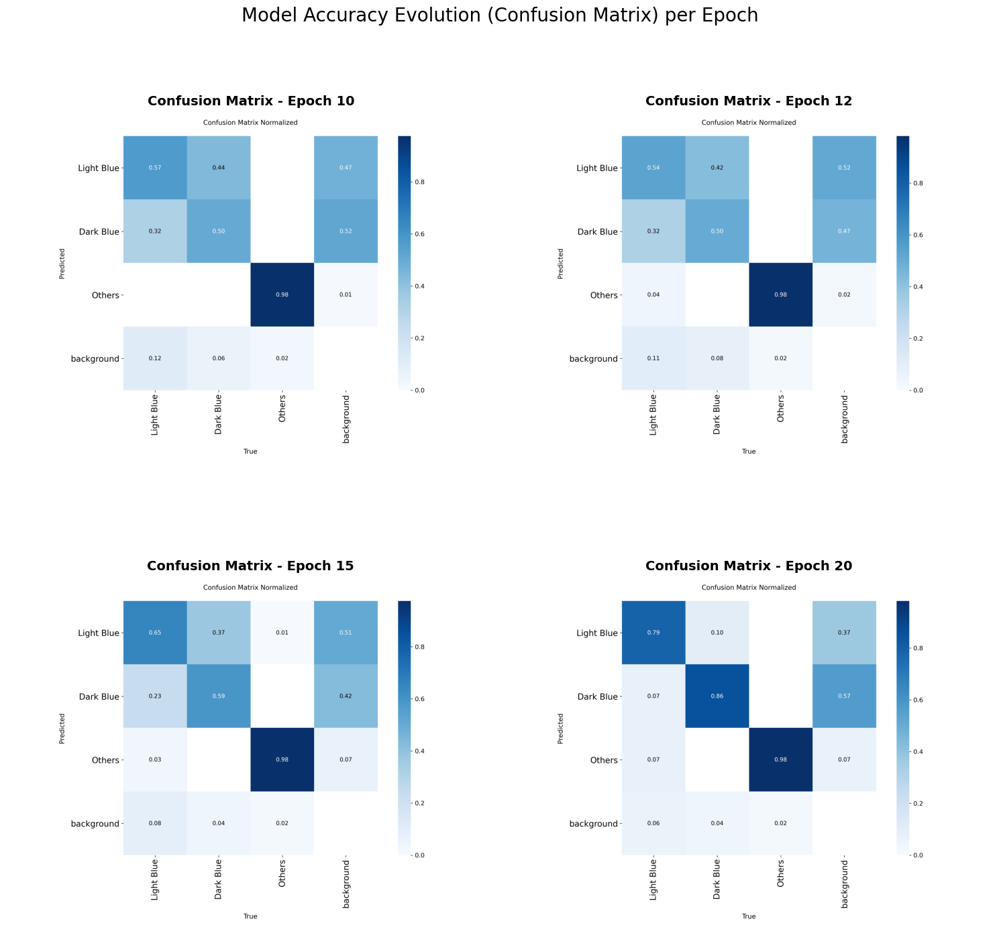

In [68]:
import cv2
import matplotlib.pyplot as plt
import os

# -------------------------------------------------------
# 1. Define Paths for Confusion Matrices
# -------------------------------------------------------
cm_files = {
    'Epoch 10': './bottle_cap_project_10_epoch/yolov8n_run/confusion_matrix_normalized.png',
    'Epoch 12': './bottle_cap_project_12_epoch/yolov8n_run/confusion_matrix_normalized.png',
    'Epoch 15': './bottle_cap_project_15_epoch/yolov8n_run/confusion_matrix_normalized.png',
    'Epoch 20': './bottle_cap_project_20_epoch/yolov8n_run/confusion_matrix_normalized.png',
}

# -------------------------------------------------------
# 2. Create 2x2 Subplot
# -------------------------------------------------------
fig, axes = plt.subplots(2, 2, figsize=(15, 15))
axes = axes.flatten()  # Flatten axes array for easy looping

print("Processing confusion matrix visualization...")

for i, (title, filepath) in enumerate(cm_files.items()):
    if os.path.exists(filepath):
        img = cv2.imread(filepath)
        img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)  # Convert BGR → RGB
        axes[i].imshow(img_rgb)
        axes[i].set_title(f'Confusion Matrix - {title}', fontsize=14, pad=10, fontweight='bold')
        axes[i].axis('off')
    else:
        axes[i].text(0.5, 0.5, f'File Not Found:\n{filepath}',
                     horizontalalignment='center',
                     verticalalignment='center',
                     transform=axes[i].transAxes,
                     fontsize=10, color='red')
        axes[i].set_title(f'{title} (Missing)', fontsize=14)
        axes[i].axis('on')

# -------------------------------------------------------
# 3. Final Layout
# -------------------------------------------------------
plt.tight_layout()
plt.suptitle('Model Accuracy Evolution (Confusion Matrix) per Epoch', fontsize=20, y=1.02)
plt.show()


## Conclusion for 4 models

Based on the analysis of 4 YOLO models, we can conclude that model 4 is the best. Also, we can conclude that the main challenge of this dataset is distinguishing between the **Light Blue** and **Dark Blue** classes on the bottle caps. Below is the brief analysis of the four models that i have trained.



*   Epochs 10 and 12 : These 2 Models experience high confusion in differentiating between light blue and dark blue colors.  
*   Epochs 15 : This model experiences better at determining the light blue colors but still not significant, especially with the 0,59% positive of dark blue color.
*   Epochs 20 : This model experiences a significant increase of accuracy where the accuracy of **Dark Blue** reached 86% and **Light Blue** reached 79%.
*   The **Others** color class is very stable to detection with 98% accuracy since the beginning of training because the color difference between **Others** class and others color is very contrasting.



## Downlaod the best model.

In [35]:
from google.colab import files
import os

# Path to the best model weights
best_model_path = '/content/bottle_cap_project_20_epoch/yolov8n_run/weights/best.pt'

if os.path.exists(best_model_path):
    print(f"Downloading model: {best_model_path}")
    files.download(best_model_path)
else:
    print(f"Error: File not found at {best_model_path}")


Sedang mendownload: /content/bottle_cap_project_20_epoch/yolov8n_run/weights/best.pt


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

## Test the model with test dataset from kaggle.com

Link : [https://www.kaggle.com/datasets/artemsmetanin/color-cap
](https://www.kaggle.com/datasets/artemsmetanin/color-cap)

In [36]:
import kagglehub

# Download latest version
path = kagglehub.dataset_download("artemsmetanin/color-cap")

print("Path to dataset files:", path)

100%|██████████| 866M/866M [00:14<00:00, 63.4MB/s]

Extracting files...


Path to dataset files: /root/.cache/kagglehub/datasets/artemsmetanin/color-cap/versions/1


## Move the Dataset to /content/dataset_test

In [69]:
import os
import shutil

SOURCE_PATH = '/root/.cache/kagglehub/datasets/artemsmetanin/color-cap/versions/1'
DEST_PATH = '/content/dataset_test/test'

if os.path.exists(SOURCE_PATH):
    # If destination exists, remove it first to avoid conflicts
    if os.path.exists(DEST_PATH):
        shutil.rmtree(DEST_PATH)

    # Move the folder
    shutil.move(SOURCE_PATH, DEST_PATH)
    print(f"✅ Successfully moved to: {DEST_PATH}")

    # Update dataset root path
    DATASET_ROOT = DEST_PATH
else:
    # Source folder doesn't exist, check if destination already exists
    if os.path.exists(DEST_PATH):
        print(f"ℹ️ Dataset already exists at {DEST_PATH}. Using existing folder.")
        DATASET_ROOT = DEST_PATH
    else:
        print(f"❌ Error: Source folder not found at {SOURCE_PATH}")
        DATASET_ROOT = None  # Flag for error

ℹ️ Dataset already exists at /content/dataset_test/test. Using existing folder.


## Config the model

In [70]:
MODEL_PATH = '/content/bottle_cap_project_20_epoch/yolov8n_run/weights/best.pt'
NUM_SAMPLES = 16

## Find the images to be tested and run for testing the model.

Searching images in: /content/dataset_test/test ...
Found a total of 100 images.
Starting predictions on 16 random images...

0: 192x320 3 Light Blues, 2 Dark Blues, 6 Otherss, 71.4ms
1: 192x320 1 Light Blue, 3 Dark Blues, 6 Otherss, 71.4ms
2: 192x320 2 Light Blues, 1 Dark Blue, 9 Otherss, 71.4ms
3: 192x320 3 Light Blues, 3 Dark Blues, 10 Otherss, 71.4ms
4: 192x320 7 Light Blues, 4 Dark Blues, 52 Otherss, 71.4ms
5: 192x320 18 Otherss, 71.4ms
6: 192x320 2 Light Blues, 3 Dark Blues, 17 Otherss, 71.4ms
7: 192x320 2 Light Blues, 1 Dark Blue, 6 Otherss, 71.4ms
8: 192x320 8 Light Blues, 3 Dark Blues, 34 Otherss, 71.4ms
9: 192x320 2 Light Blues, 3 Dark Blues, 11 Otherss, 71.4ms
10: 192x320 3 Light Blues, 4 Dark Blues, 18 Otherss, 71.4ms
11: 192x320 2 Dark Blues, 9 Otherss, 71.4ms
12: 192x320 1 Dark Blue, 11 Otherss, 71.4ms
13: 192x320 3 Light Blues, 2 Dark Blues, 14 Otherss, 71.4ms
14: 192x320 4 Light Blues, 1 Dark Blue, 17 Otherss, 71.4ms
15: 192x320 2 Light Blues, 1 Dark Blue, 9 Otherss, 71

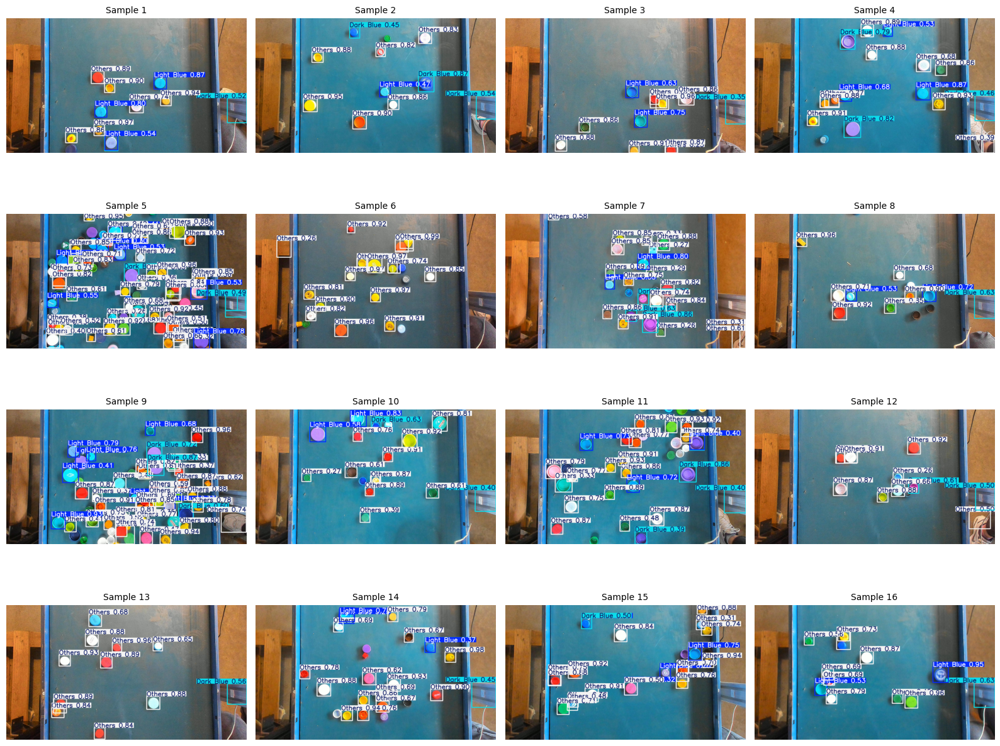

In [71]:
if DATASET_ROOT:
    print(f"Searching images in: {DATASET_ROOT} ...")

    image_extensions = ['*.jpg', '*.jpeg', '*.png', '*.JPG', '*.PNG']
    all_images = []

    for ext in image_extensions:
        all_images.extend(glob.glob(os.path.join(DATASET_ROOT, '**', ext), recursive=True))

    print(f"Found a total of {len(all_images)} images.")

    if len(all_images) == 0:
        print("Error: No images found.")
    elif not os.path.exists(MODEL_PATH):
        print(f"Error: Model file not found at {MODEL_PATH}")
    else:
        test_samples = random.sample(all_images, min(NUM_SAMPLES, len(all_images)))
        print(f"Starting predictions on {len(test_samples)} random images...")

        model = YOLO(MODEL_PATH)
        results = model.predict(source=test_samples, conf=0.25, save=False, stream=True)

        plt.figure(figsize=(16, 16))
        cols = 4
        rows = (len(test_samples) // cols) + 1

        for i, result in enumerate(results):
            img_rgb = cv2.cvtColor(result.plot(), cv2.COLOR_BGR2RGB)
            plt.subplot(rows, cols, i + 1)
            plt.imshow(img_rgb)
            plt.axis('off')
            plt.title(f"Sample {i+1}", fontsize=10)

        plt.tight_layout()
        plt.savefig('Test_Robustness_Result.png')
        plt.show()

## 4. Insights, Bias Analysis & Robustness

After evaluating the model on both the validation set and an external test set (Kaggle Dataset with white background), several observations were made:

### 🔍 Observation 1: Domain Shift (Background Bias)
The model was trained on images with a **green tray background**. When tested on the Kaggle dataset (white background), the model successfully localized the caps, but the **confidence scores dropped significantly**.
* **Insight:** The model likely learned to associate "caps" partly with the "green background" context.
* **Solution:** To fix this in production, **Mosaic Augmentation** or **Copy-Paste Augmentation** (placing caps on random background images) should be increased during training to force the model to learn cap features independently of the background.

### 🎨 Observation 2: Color Bias (Light vs. Dark Blue)
The distinction between Light Blue and Dark Blue is highly sensitive to lighting conditions.
* **Insight:** In overexposed images, Dark Blue caps can be misclassified as Light Blue due to pixel washing.
* **Solution:** The application of **RandomGamma** and **HueSaturationValue** augmentations during the data pipeline helped mitigate this, but strict lighting control on the production line would be the most effective physical solution.

In [73]:
from google.colab import files as gfiles  # alias to avoid conflicts

# Configuration
target_folder = '/content/dataset_test/test'
zip_name = 'kaggle_test_subset'

if os.path.exists(target_folder):
    print(f"Compressing folder: {target_folder} ...")

    # Create ZIP archive
    shutil.make_archive(zip_name, 'zip', target_folder)

    size_mb = os.path.getsize(zip_name + '.zip') / (1024*1024)
    print(f"Compression complete. File size: {size_mb:.2f} MB")
    print("Starting download...")

    # Download the ZIP file
    gfiles.download(f"{zip_name}.zip")
else:
    print(f"Error: Folder '{target_folder}' not found.")

Compressing folder: /content/dataset_test/test ...
Compression complete. File size: 22.27 MB
Starting download...


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>